In [1]:
%matplotlib inline

import ROOT
import uuid
import math

import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import json
from sklearn.cluster import DBSCAN
from sklearn import metrics
from sklearn.datasets.samples_generator import make_blobs
from sklearn.preprocessing import StandardScaler
import clusterTools as clAlgo

#with open('tc_dump_ev_0.json') as data_file:    
#    data = json.load(data_file)

event = 0


tcs = pd.read_json('tc_dump_ev_{}.json'.format(event))
cl2d = pd.read_json('2dc_dump_ev_{}.json'.format(event))
mcl2d = pd.read_json('m2dc_dump_ev_{}.json'.format(event))



Welcome to JupyROOT 6.10/08


In [16]:
# define some utility functions
ROOT.enableJSVis()

from drawingTools import *

# some useful globals, mainly to deal with ROOT idiosyncrasies
c_idx = 0
p_idx = 0
colors = [1,2,3,4,5]
stuff = []

    


def plotLayer(sel_layer, zside, tcs, cl2d, mcl2d):
    plt.figure(figsize=(12,12))
    plt.title('Layer {}'.format(sel_layer))
    tcs_layer = tcs[(tcs.layer == sel_layer) & (tcs.zside == zside)]
    plt.scatter(tcs_layer['x'], tcs_layer['y'], label='all', marker="s", c="tab:gray",edgecolor="w",linewidth=0.3,
            s=100*tcs_layer['energy']**0.5,alpha = 0.2)
    plt.xlabel("X [cm]")
    plt.ylabel("y [cm]")

    selection = None
    if zside > 0:
        selection = (cl2d.layer == sel_layer) & (cl2d.eta > 0)
        selection1 = (mcl2d.layer == sel_layer) & (mcl2d.eta > 0)
    else:
        selection = (cl2d.layer == sel_layer) & (cl2d.eta < 0)
        selection1 = (mcl2d.layer == sel_layer) & (mcl2d.eta < 0)
    cl2d_layer = cl2d[selection]


    for index, cluster in cl2d_layer.iterrows(): 
        #print type(cluster.cells)
        #print cluster.cells
        cluster_cells = tcs[tcs.index.isin(cluster.cells)]
        plt.scatter(cluster_cells['x'], cluster_cells['y'], label='all', marker="s", c=np.random.rand(3,),edgecolor="w",linewidth=0.3,
                    s=100*cluster_cells['energy'],alpha = 0.8)

    
    mcl2d_layer = mcl2d[selection1]
    for index, cluster in mcl2d_layer.iterrows(): 
        cluster_cells = tcs[tcs.index.isin(cluster.cells)]
        print '# layer {}, matched cells: {}'.format(sel_layer, cluster_cells.shape[0])
        plt.scatter(cluster_cells['x'], cluster_cells['y'], label='all', marker="o", facecolors='none', edgecolors='r',linewidth=0.6,
                    s=100*cluster_cells['energy'],alpha =1)

        
    plt.xlim([-150,150])
    plt.ylim([-150,150])
    plt.show()
    


# Trigger Cells

In [3]:
tcsl4 = tcs[(tcs.zside==1) & (tcs.layer == 10)]
tcsl4


,cell,data,energy,eta,id,layer,n,phi,radius,subdet,wafer,wafertype,x,y,z,zside
6929,33,496,0.154498,2.878629,1733560609,10,NaN,1.471859,37.152523,3,9,1,3.669768,36.970837,329.425018,1
6930,37,736,0.229255,2.934914,1733560613,10,NaN,1.429386,35.107304,3,9,1,4.948001,34.756870,329.425018,1
6931,38,1444,0.449787,2.973508,1733560614,10,NaN,1.460687,33.771084,3,9,1,3.711001,33.566570,329.425018,1
6932,23,421,0.131136,2.708434,1733563671,10,NaN,1.979477,44.102352,3,21,1,-17.526249,40.470333,329.425018,1
6933,35,566,0.176302,2.594501,1733563939,10,NaN,1.547068,49.480968,3,22,1,1.174006,49.467041,329.425018,1
6934,41,392,0.122103,2.596539,1733563945,10,NaN,1.453623,49.379105,3,22,1,5.772668,49.040516,329.425018,1
6935,44,1347,0.419573,2.589243,1733563948,10,NaN,1.404455,49.744766,3,22,1,8.236486,49.058151,329.425018,1
6936,46,693,0.215861,2.682355,1733563950,10,NaN,1.441119,45.278431,3,22,1,5.855134,44.898258,329.425018,1
6937,33,385,0.119923,2.046535,1733575201,10,NaN,1.529209,86.555824,3,66,1,3.598544,86.480988,329.425018,1
6938,0,696,0.216795,1.961986,1733582848,10,NaN,1.803787,94.487793,3,96,1,-21.816187,91.934738,329.425018,1


In [4]:
print 'eps={}'.format(math.sqrt((tcsl4.iloc[0].x-tcsl4.iloc[1].x)**2+(tcsl4.iloc[0].y-tcsl4.iloc[1].y)**2))
print 'Sum E= {}'.format(tcsl4.energy.sum())

eps=2.55646776405
Sum E= 62.466562331


# NN 2D clusters

In [5]:
cl2d[:3]

,cells,energy,eta,layer,n,ncells,phi,pt
0,"[1, 2, 20, 21, 67, 69, 70, 71, 16, 17, 18, 22,...",5.916557,-2.797002,1,NaN,13,1.088414,0.718946
1,"[3, 5, 7]",2.558034,-2.957909,1,NaN,3,1.385488,0.264947
10,[94],0.200571,-2.171122,1,NaN,1,1.224760,0.045163


Matched to GEN info

In [6]:
mcl2d

,cells,energy,eta,layer,n,ncells,phi,pt
25,[65],0.412668,2.776625,3,NaN,1,0.595218,0.051177
26,[68],1.115607,2.778928,4,NaN,1,0.595218,0.138037
27,[69],0.833477,2.782694,5,NaN,1,0.595218,0.102744
28,[70],1.448829,2.784984,6,NaN,1,0.595218,0.178194
29,"[71, 72]",1.872726,2.789075,7,NaN,2,0.590154,0.229396
30,"[73, 74, 75]",3.291236,2.788910,8,NaN,3,0.583259,0.403218
31,"[76, 77, 78]",2.823827,2.788610,9,NaN,3,0.592412,0.346058
32,"[79, 80, 81, 82]",2.902126,2.794572,10,NaN,4,0.591140,0.353554
33,"[83, 84, 85, 86]",3.702678,2.794215,11,NaN,4,0.588521,0.451243
34,"[87, 88, 89, 90]",4.313855,2.797139,12,NaN,4,0.586317,0.524202


In [7]:


#plt.figure(figsize=(12,12))
#plt.axvspan(320.75, 350.40, alpha=0.1, color="0.8",linewidth=0)
#plt.axvspan(350.40, 410, alpha=0.1, color='0.5',linewidth=0)
#plt.axvspan(410, 500, alpha=0.1, color='0.1',linewidth=0)

# Build 2D clusters with DBSCAN

In [8]:
new2Dcls = pd.DataFrame(columns=['energy','layer','eta','cells'])

zside = 1

for slayer in range(1, 29):
    new2Dcls = new2Dcls.append(clAlgo.buildDBSCANClusters(slayer, zside, tcs), ignore_index=True)
#print new2Dcls



clusterTools.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  tcs_layer['dbs_label'] = labels
clusterTools.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  tcs_layer['core'] = core_samples_mask


In [9]:
zside = -1

for layer in range(1, 29):
    new2Dcls = new2Dcls.append(clAlgo.buildDBSCANClusters(layer, zside, tcs), ignore_index=True)

In [10]:
new2Dcls[new2Dcls.energy != new2Dcls.energyCore]

,cells,energy,energyCore,eta,layer,nCoreCells,ncells,phi,x,y,z,zside
101,"[4578, 4579, 4580, 4581]",0.401158,0.325081,1.679733,2.0,3.0,4.0,0.052898,124.014642,6.566294,321.505035,1.0
113,"[4717, 4718, 4719]",0.746451,0.595701,2.687350,3.0,2.0,3.0,-2.545356,-36.520402,-24.783711,322.735016,1.0
117,"[4782, 4806, 4807]",0.621528,0.285218,2.868803,3.0,1.0,3.0,-0.703595,28.030101,-23.782204,322.735016,1.0
127,"[5061, 5062, 5063, 5064]",0.811861,0.213352,2.577386,4.0,1.0,4.0,-1.449000,6.006408,-49.070920,323.485046,1.0
128,"[5076, 5077, 5107, 5108, 5109]",1.377805,0.974121,2.830634,4.0,3.0,5.0,-0.675522,29.879634,-23.941986,323.485016,1.0
129,"[5117, 5118, 5119, 5120, 5121, 5122]",2.374103,1.687727,2.685272,4.0,4.0,6.0,-0.267597,42.753488,-11.721860,323.485016,1.0
130,"[5132, 5134, 5135, 5136, 5137]",2.084674,1.914835,2.842958,4.0,4.0,5.0,0.133413,37.480294,5.030257,323.485046,1.0
132,"[5292, 5293, 5294, 5295, 5296, 5305]",1.133573,0.533661,2.130096,5.0,1.0,6.0,2.993156,-77.413536,11.576170,324.714996,1.0
133,"[5325, 5326, 5327, 5329]",1.153224,0.109203,2.662135,5.0,1.0,4.0,-2.557504,-37.999747,-25.118918,324.714996,1.0
134,"[5383, 5389, 5390]",11.546276,11.436793,2.683508,5.0,2.0,3.0,-1.402814,7.453317,-43.951650,324.714996,1.0


# Build 3D clusters with DBSCAN

In [11]:
cl3D = pd.DataFrame()

cl3D = cl3D.append(clAlgo.build3DClustersProj(new2Dcls[new2Dcls.eta>0]))
cl3D = cl3D.append(clAlgo.build3DClustersProj(new2Dcls[new2Dcls.eta<0]))

colorlist = [np.random.rand(3,) for aaa in range(0, cl3D.shape[0])]
cl3D['color'] = colorlist

cl3D.sort(columns='energy', ascending=False)


clusterTools.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  cl2D['projx'] = cl2D.x/cl2D.z
clusterTools.py:161: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  cl2D['projy'] = cl2D.y/cl2D.z
clusterTools.py:172: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  cl2D['dbs_labels'] = labels
/opt/local/Library/Frameworks/

,energy,eta,phi,energyCore,energyCentral,pt,layers,clusters,nclu,firstlayer,showerlength,seetot,seemax,spptot,sppmax,szz,emaxe,color
1,49.385347,-2.151550,-0.203464,48.735224,28.270178,11.334091,"[1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, ...","[674, 706, 739, 751, 755, 758, 763, 765, 767, ...",23,1.0,1,1,1,1,1,1,1,"[0.307214442765, 0.527184446026, 0.563279068696]"
0,37.253128,2.134329,3.018798,32.839696,26.950701,8.694149,"[1.0, 2.0, 5.0, 6.0, 7.0, 9.0, 10.0, 11.0, 12....","[14, 83, 132, 139, 143, 149, 151, 155, 157, 16...",18,1.0,1,1,1,1,1,1,1,"[0.425917950093, 0.453565132182, 0.976760926829]"
15,35.731711,2.893981,2.746520,30.077833,23.674147,3.943800,"[4.0, 5.0, 7.0, 8.0, 9.0, 10.0, 11.0, 12.0, 13...","[122, 131, 142, 146, 148, 150, 154, 156, 161, ...",18,4.0,1,1,1,1,1,1,1,"[0.150063548661, 0.646704789609, 0.556768116237]"
16,26.724724,2.846258,1.253234,26.408567,19.172308,3.092910,"[14.0, 15.0, 16.0, 17.0, 18.0, 19.0, 20.0, 21....","[166, 171, 180, 190, 199, 229, 261, 330, 378, ...",12,14.0,1,1,1,1,1,1,1,"[0.153966833237, 0.00139632927514, 0.945057160..."
4,11.715805,2.746403,-0.308299,11.715805,0.303541,1.497168,"[1.0, 19.0, 22.0, 23.0, 28.0]","[42, 217, 368, 408, 619]",5,1.0,1,1,1,1,1,1,1,"[0.581347807026, 0.390572348798, 0.112194449026]"
19,10.866578,1.995982,1.590616,10.866578,0.235305,2.899569,"[20.0, 25.0, 26.0, 27.0]","[234, 480, 520, 564]",4,20.0,1,1,1,1,1,1,1,"[0.883793992715, 0.476692097185, 0.907777617389]"
5,9.180531,2.846713,0.139726,7.056465,0.000000,1.062003,"[1.0, 2.0, 4.0, 5.0, 6.0, 21.0, 24.0]","[48, 97, 130, 137, 141, 317, 458]",7,1.0,1,1,1,1,1,1,1,"[0.428366953162, 0.21422891311, 0.951948575703]"
3,6.154920,-2.958783,-1.956912,6.154920,0.355916,0.636945,"[4.0, 6.0, 7.0, 19.0, 27.0]","[754, 759, 764, 800, 1082]",5,4.0,1,1,1,1,1,1,1,"[0.631667360376, 0.490777180537, 0.50369899086]"
13,5.476593,2.680847,-0.249242,4.136119,0.000000,0.746845,"[1.0, 2.0, 3.0, 4.0, 5.0]","[41, 95, 118, 129, 136]",5,1.0,1,1,1,1,1,1,1,"[0.995268018058, 0.801112738222, 0.00154580394..."
24,4.912424,2.284508,2.831767,4.912424,0.000000,0.990141,"[21.0, 22.0, 23.0, 24.0, 25.0, 26.0, 27.0, 28.0]","[279, 341, 391, 436, 488, 528, 570, 601]",8,21.0,1,1,1,1,1,1,1,"[0.423223447608, 0.99186492007, 0.307551855786]"


In [12]:
cl3D1 = pd.DataFrame()

cl3D1 = cl3D1.append(clAlgo.build3DClustersEtaPhi(new2Dcls[new2Dcls.eta>0]))
cl3D1 = cl3D1.append(clAlgo.build3DClustersEtaPhi(new2Dcls[new2Dcls.eta<0]))

colorlist = [np.random.rand(3,) for aaa in range(0, cl3D1.shape[0])]
cl3D1['color'] = colorlist

cl3D1.sort(columns='energy', ascending=False)

clusterTools.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  cl2D['dbs_labels'] = labels
/opt/local/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel_launcher.py:9: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  if __name__ == '__main__':


,energy,energyCore,energyCentral,eta,phi,pt,layers,clusters,nclu,firstlayer,showerlength,seetot,seemax,spptot,sppmax,szz,emaxe,color
0,49.385347,48.735224,28.270178,-2.151550,-0.203464,11.334091,"[1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, ...","[674, 706, 739, 751, 755, 758, 763, 765, 767, ...",23,1.0,1,1,1,1,1,1,1,"[0.1185363479, 0.811303731698, 0.919176742326]"
0,36.817927,32.404495,26.950701,2.134493,3.018552,8.591218,"[1.0, 2.0, 5.0, 6.0, 7.0, 9.0, 10.0, 11.0, 12....","[14, 83, 132, 139, 143, 149, 151, 155, 157, 16...",17,1.0,1,1,1,1,1,1,1,"[0.702822857412, 0.879447171493, 0.894015903091]"
3,26.724724,26.408567,19.172308,2.846258,1.253234,3.092910,"[14.0, 15.0, 16.0, 17.0, 18.0, 19.0, 20.0, 21....","[166, 171, 180, 190, 199, 229, 261, 330, 378, ...",12,14.0,1,1,1,1,1,1,1,"[0.877053164607, 0.183639679313, 0.558579027636]"
5,18.344468,18.344468,0.000000,2.157321,0.089045,4.186528,[28.0],[623],1,28.0,1,1,1,1,1,1,1,"[0.00850916672094, 0.476999388006, 0.603629539..."
2,16.348084,12.648105,12.698221,2.907239,2.742574,1.780758,"[9.0, 10.0, 11.0, 14.0, 15.0, 18.0]","[148, 150, 154, 164, 167, 193]",6,9.0,1,1,1,1,1,1,1,"[0.116554343066, 0.512552981969, 0.886029013885]"
1,12.516164,12.397484,0.000000,2.683508,-1.402814,1.702338,[5.0],[134],1,5.0,1,1,1,1,1,1,1,"[0.77564497817, 0.473891458631, 0.754715146187]"
4,10.866578,10.866578,0.235305,1.995982,1.590616,2.899569,"[20.0, 25.0, 26.0, 27.0]","[234, 480, 520, 564]",4,20.0,1,1,1,1,1,1,1,"[0.88445578307, 0.972380537766, 0.604410282001]"


In [13]:
cl3D2 = pd.DataFrame()

cl3D2 = cl3D2.append(clAlgo.build3DClustersEtaPhi2(new2Dcls[new2Dcls.eta>0]))
cl3D2 = cl3D2.append(clAlgo.build3DClustersEtaPhi2(new2Dcls[new2Dcls.eta<0]))

colorlist = [np.random.rand(3,) for aaa in range(0, cl3D2.shape[0])]
cl3D2['color'] = colorlist

cl3D2.sort(columns='energy', ascending=False)

clusterTools.py:123: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  cl2D['dbs_labels'] = labels
/opt/local/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel_launcher.py:9: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  if __name__ == '__main__':


,energy,eta,phi,pt,layers,clusters,nclu,firstlayer,showerlength,seetot,seemax,spptot,sppmax,szz,emaxe,color
0,49.385347,-2.151550,-0.203464,11.334091,"[1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, ...","[674, 706, 739, 751, 755, 758, 763, 765, 767, ...",23,1.0,1,1,1,1,1,1,1,"[0.806784970183, 0.555667757585, 0.7417013226]"
0,37.253128,2.134329,3.018798,8.694149,"[1.0, 2.0, 5.0, 6.0, 7.0, 9.0, 10.0, 11.0, 12....","[14, 83, 132, 139, 143, 149, 151, 155, 157, 16...",18,1.0,1,1,1,1,1,1,1,"[0.160519599748, 0.111265977336, 0.1344656567]"
7,26.724724,2.846258,1.253234,3.092910,"[14.0, 15.0, 16.0, 17.0, 18.0, 19.0, 20.0, 21....","[166, 171, 180, 190, 199, 229, 261, 330, 378, ...",12,14.0,1,1,1,1,1,1,1,"[0.491367661315, 0.172418257451, 0.386977154008]"
5,16.348084,2.907239,2.742574,1.780758,"[9.0, 10.0, 11.0, 14.0, 15.0, 18.0]","[148, 150, 154, 164, 167, 193]",6,9.0,1,1,1,1,1,1,1,"[0.358099818189, 0.37865690178, 0.610577816525]"
10,10.866578,1.995982,1.590616,2.899569,"[20.0, 25.0, 26.0, 27.0]","[234, 480, 520, 564]",4,20.0,1,1,1,1,1,1,1,"[0.878741260355, 0.803949050362, 0.253462198826]"
6,6.437446,2.927733,2.755473,0.687073,"[12.0, 13.0, 17.0]","[156, 161, 181]",3,12.0,1,1,1,1,1,1,1,"[0.907454551559, 0.146163722935, 0.404334538183]"
14,4.912424,2.284508,2.831767,0.990141,"[21.0, 22.0, 23.0, 24.0, 25.0, 26.0, 27.0, 28.0]","[279, 341, 391, 436, 488, 528, 570, 601]",8,21.0,1,1,1,1,1,1,1,"[0.245262288299, 0.611144615837, 0.23964064408]"
3,3.756590,2.218858,-0.152102,0.807387,"[1.0, 2.0, 10.0]","[49, 99, 153]",3,1.0,1,1,1,1,1,1,1,"[0.295210997587, 0.124458307451, 0.698477965207]"
8,3.005977,2.686086,1.334585,0.407803,"[16.0, 17.0, 18.0, 19.0]","[179, 189, 198, 228]",4,16.0,1,1,1,1,1,1,1,"[0.969218062735, 0.208589115817, 0.375089754634]"
1,2.956433,2.667561,-2.554199,0.408510,"[1.0, 2.0, 4.0, 5.0]","[20, 88, 125, 133]",4,1.0,1,1,1,1,1,1,1,"[0.558433629897, 0.586073196301, 0.910854469095]"


# Draw clusters

## NN 2D clusters

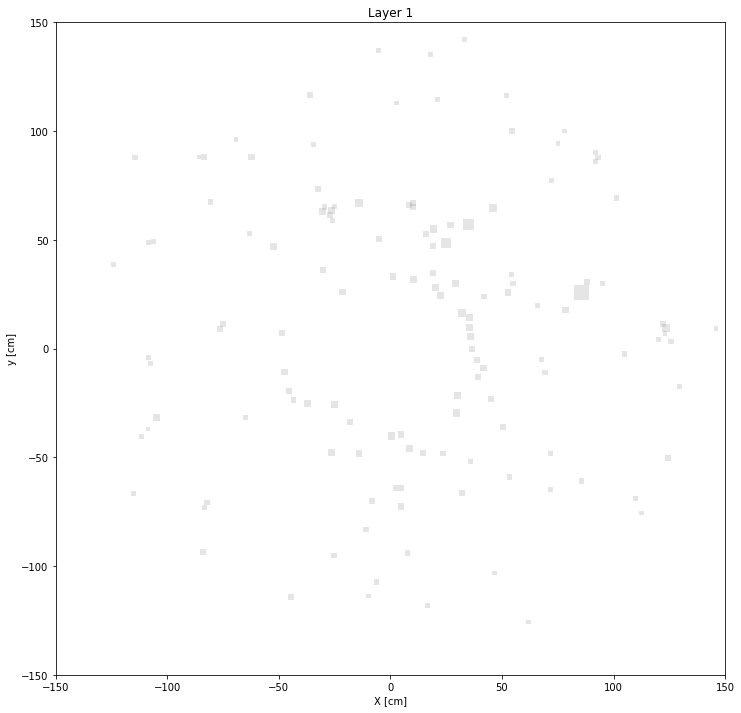

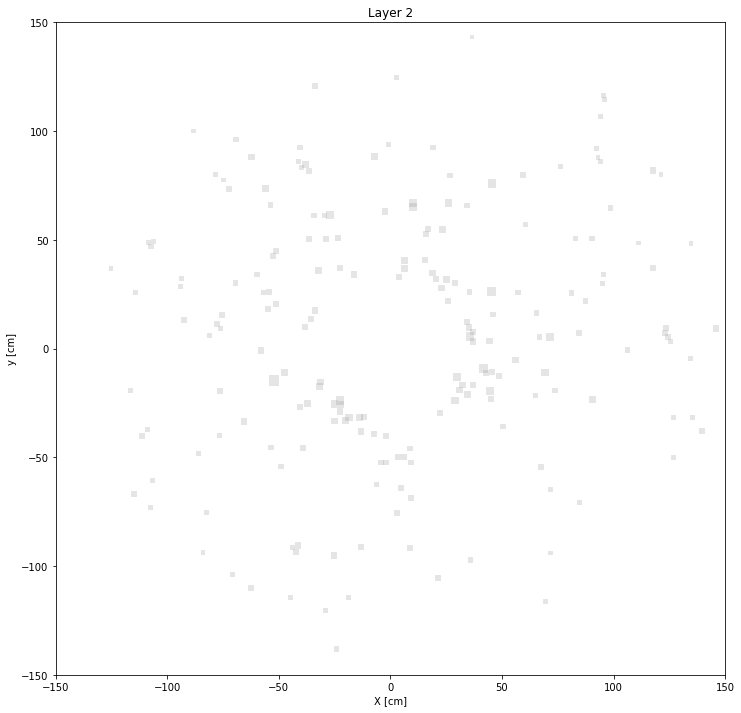

# layer 3, matched cells: 1


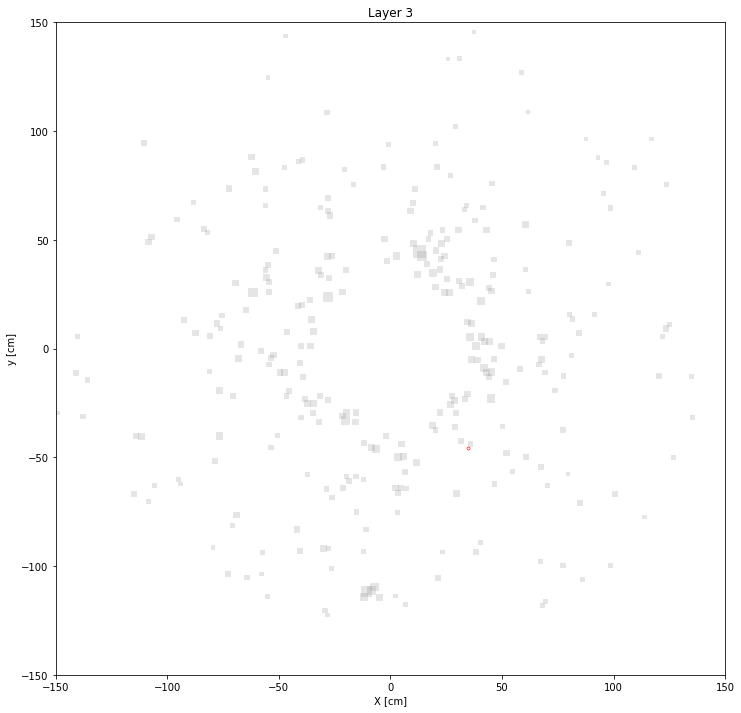

# layer 4, matched cells: 1


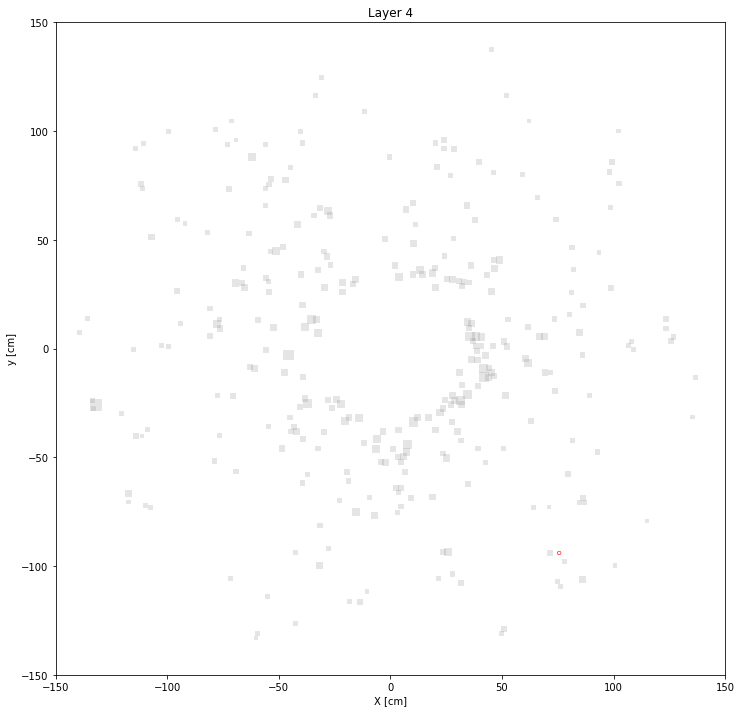

# layer 5, matched cells: 1


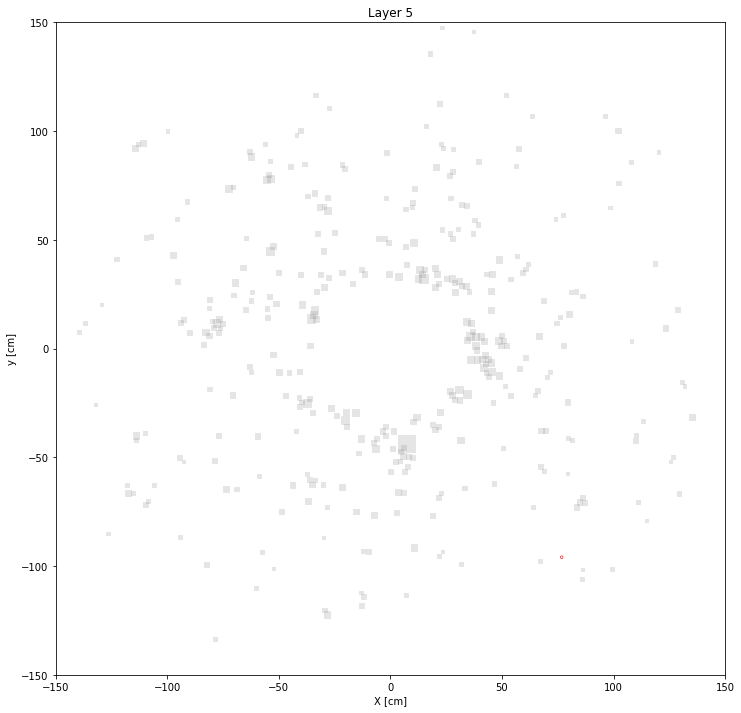

# layer 6, matched cells: 1


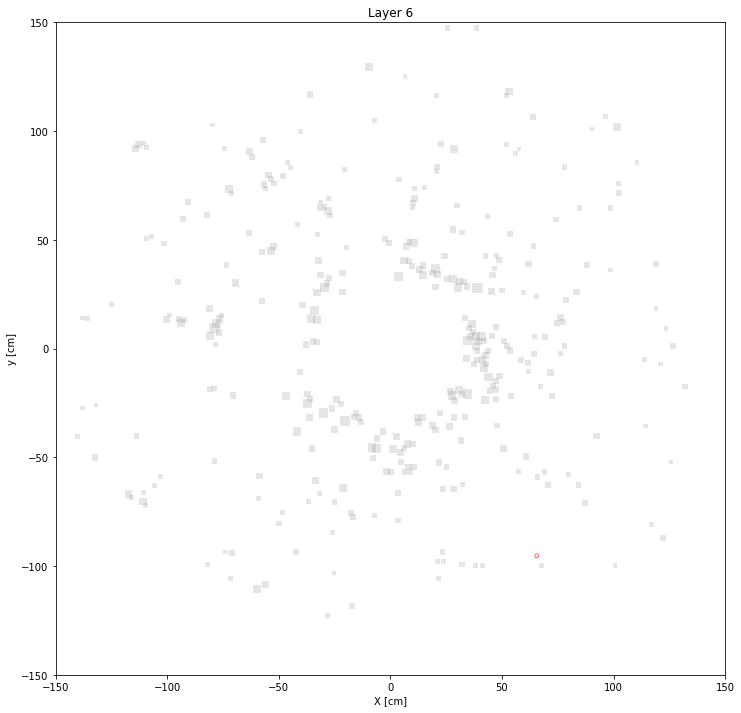

# layer 7, matched cells: 2


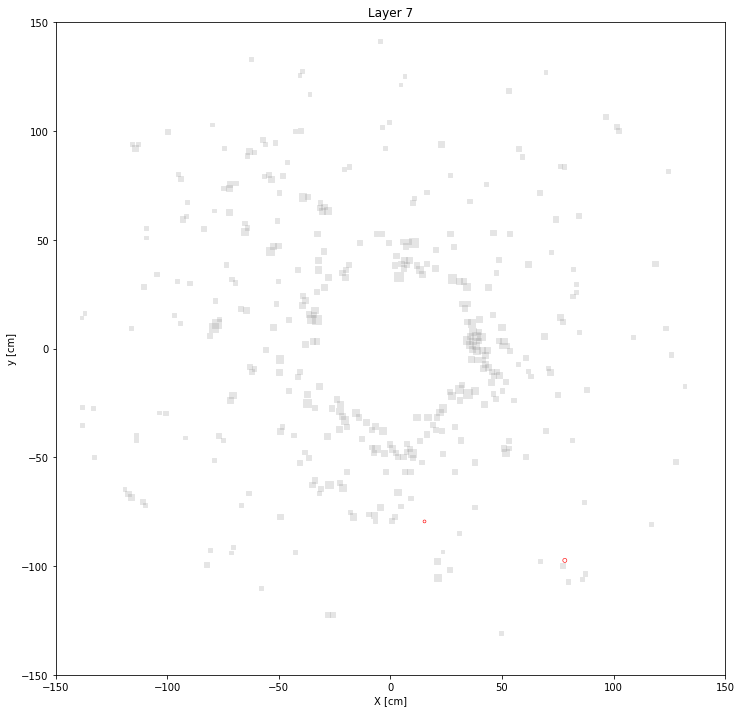

# layer 8, matched cells: 3


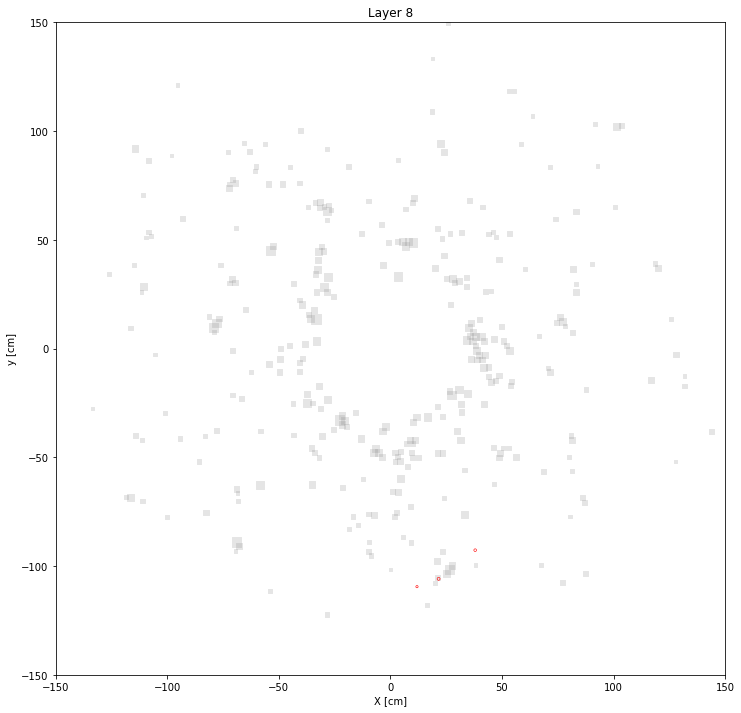

# layer 9, matched cells: 3


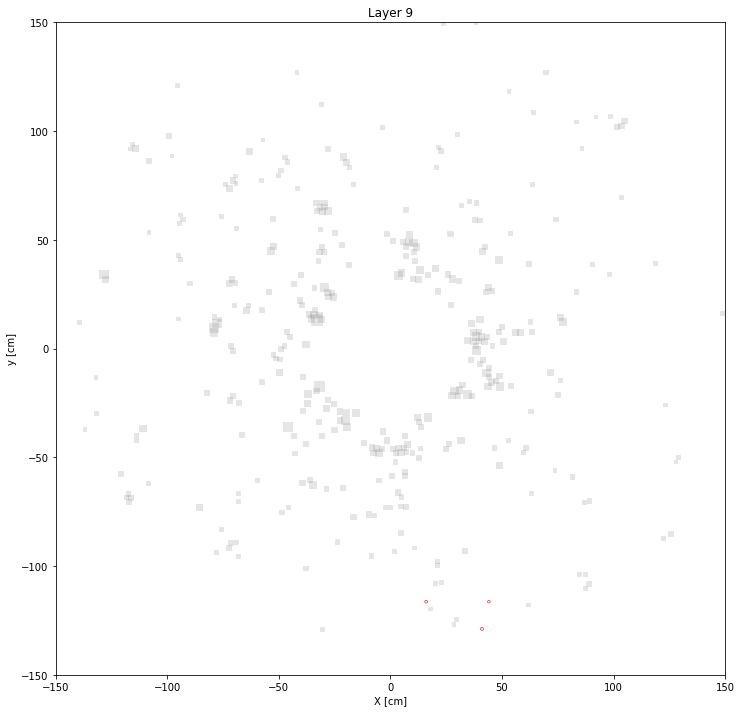

# layer 10, matched cells: 4


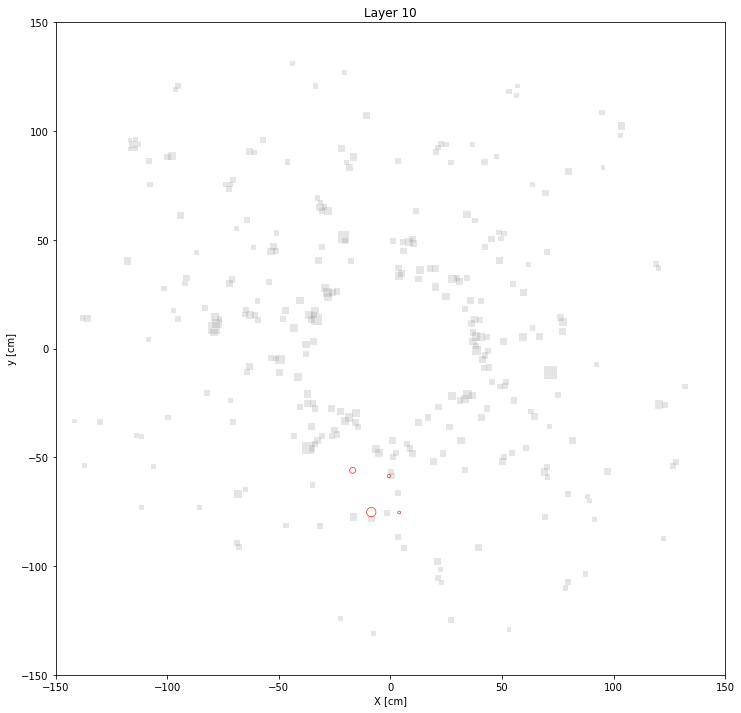

# layer 11, matched cells: 4


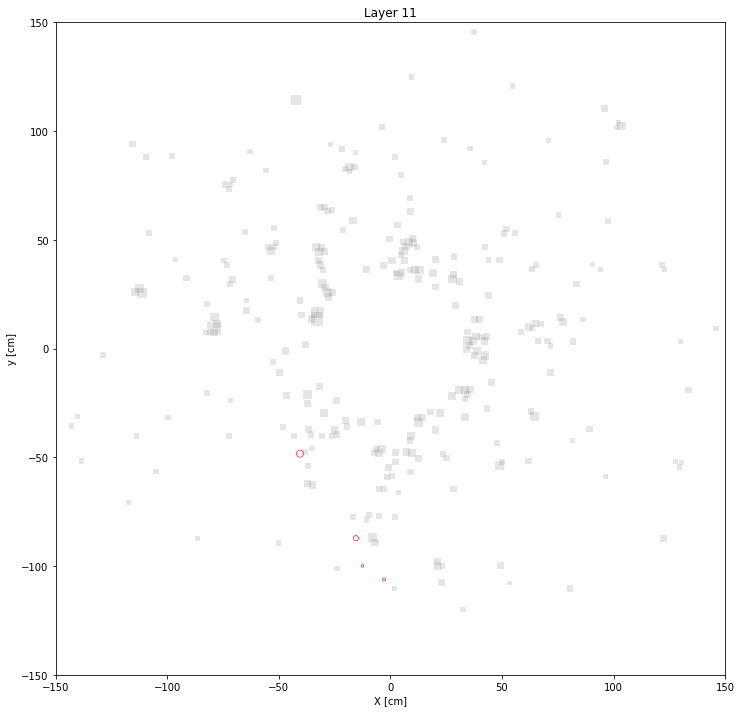

# layer 12, matched cells: 4


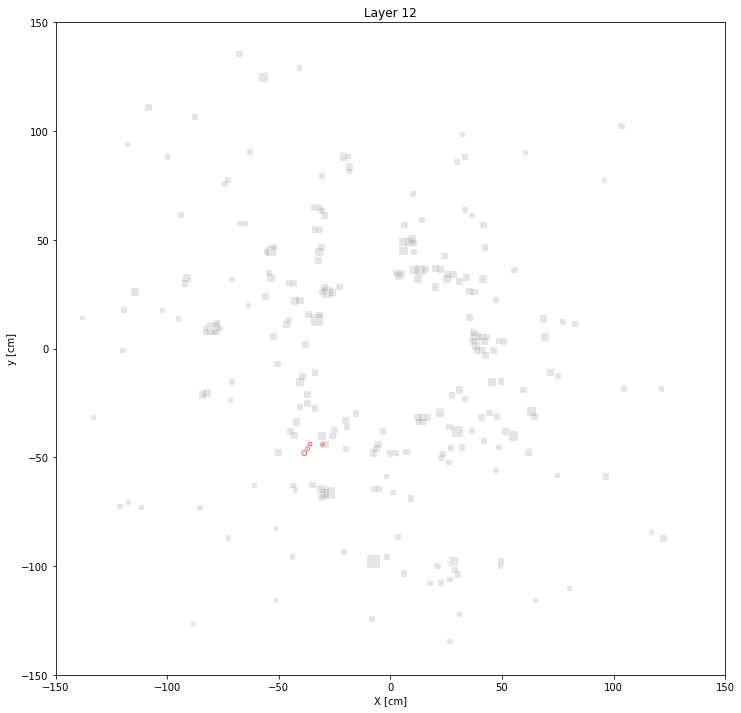

# layer 13, matched cells: 3


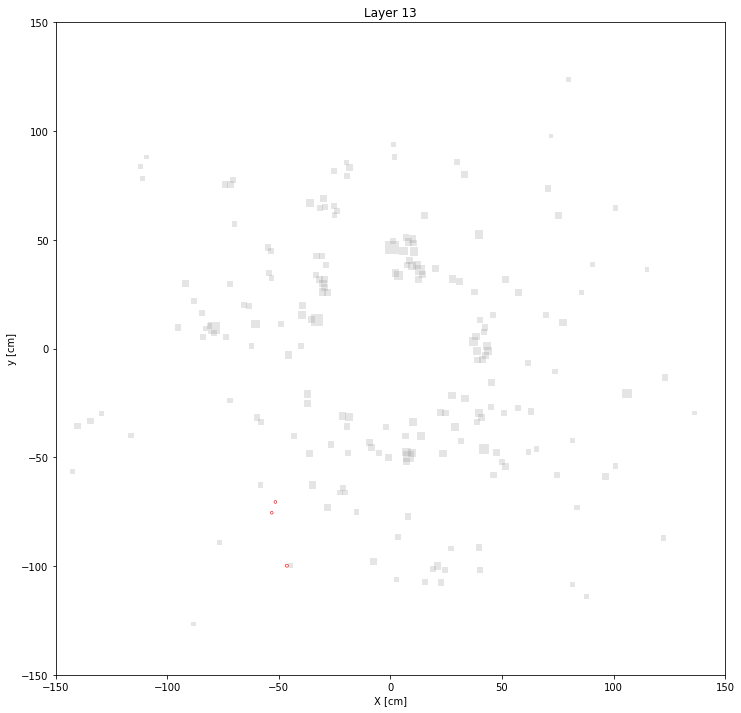

# layer 14, matched cells: 2


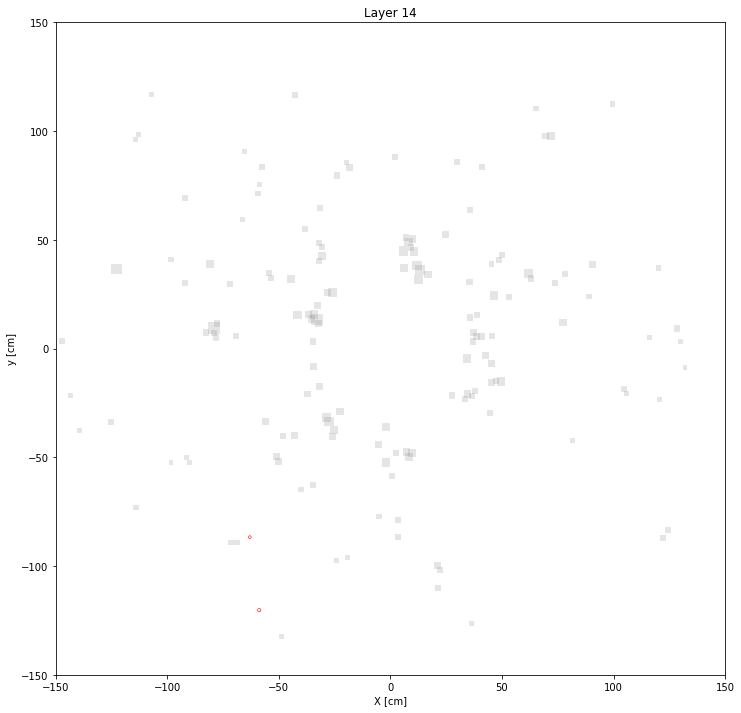

# layer 15, matched cells: 3


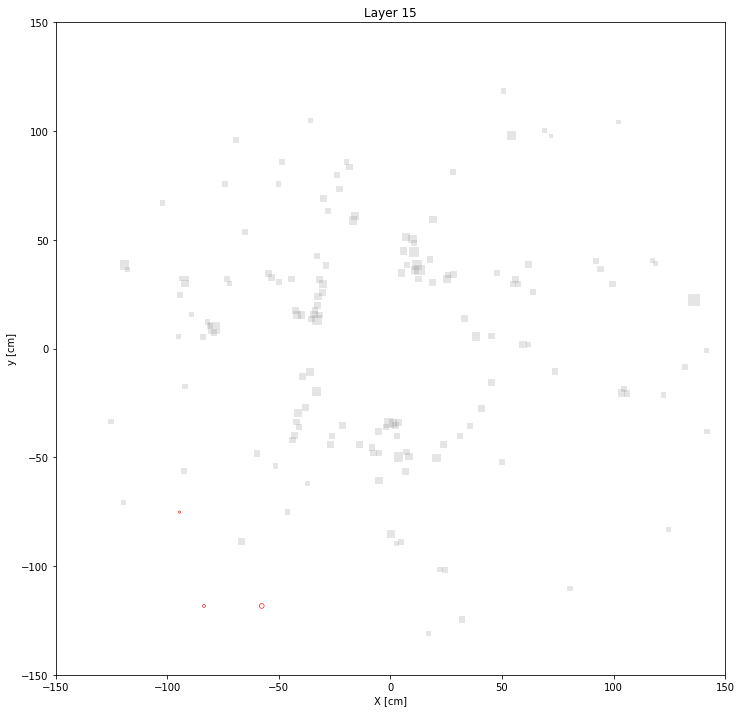

# layer 16, matched cells: 3


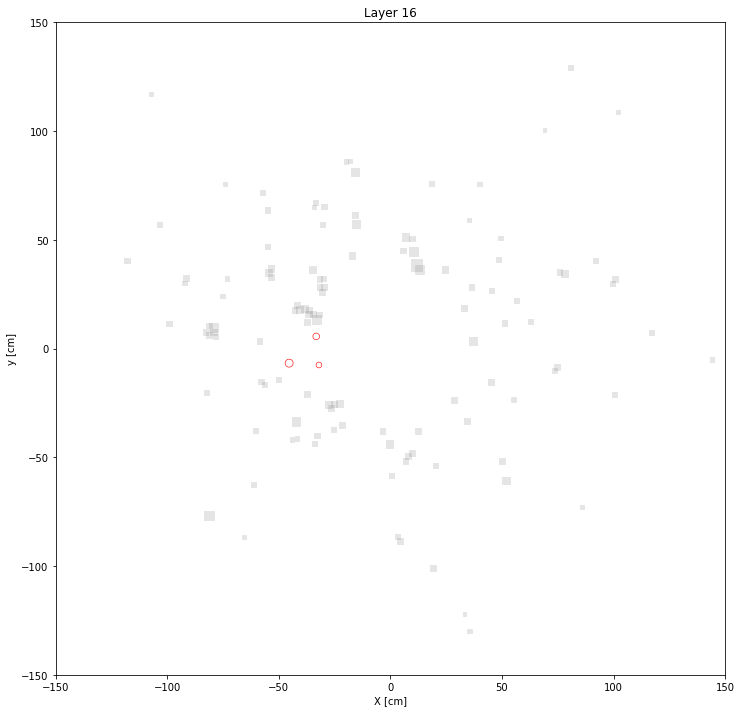

# layer 17, matched cells: 4


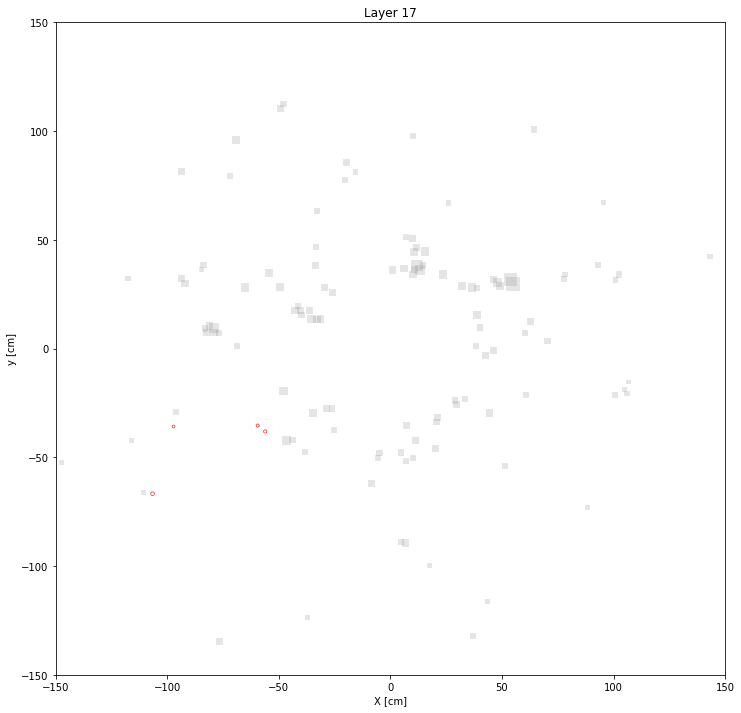

# layer 18, matched cells: 4


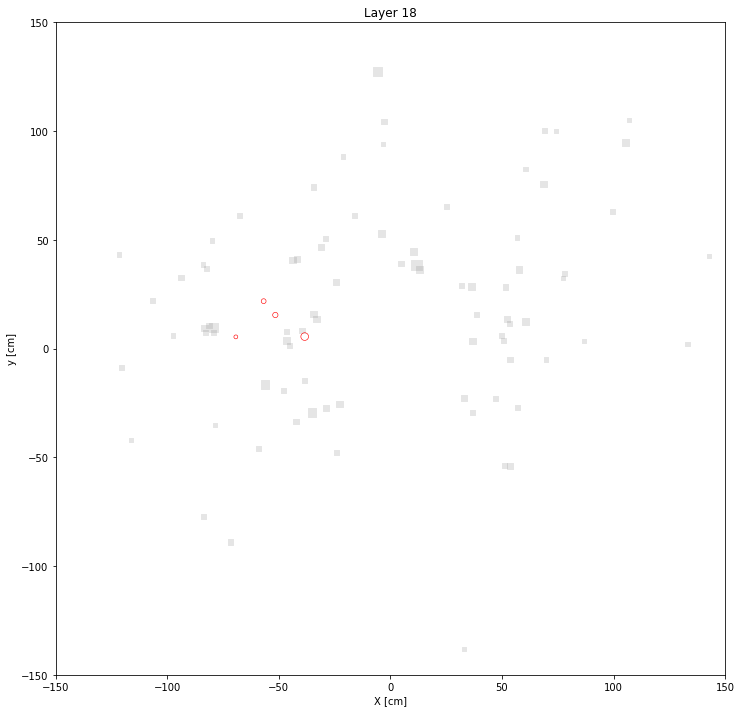

# layer 19, matched cells: 2


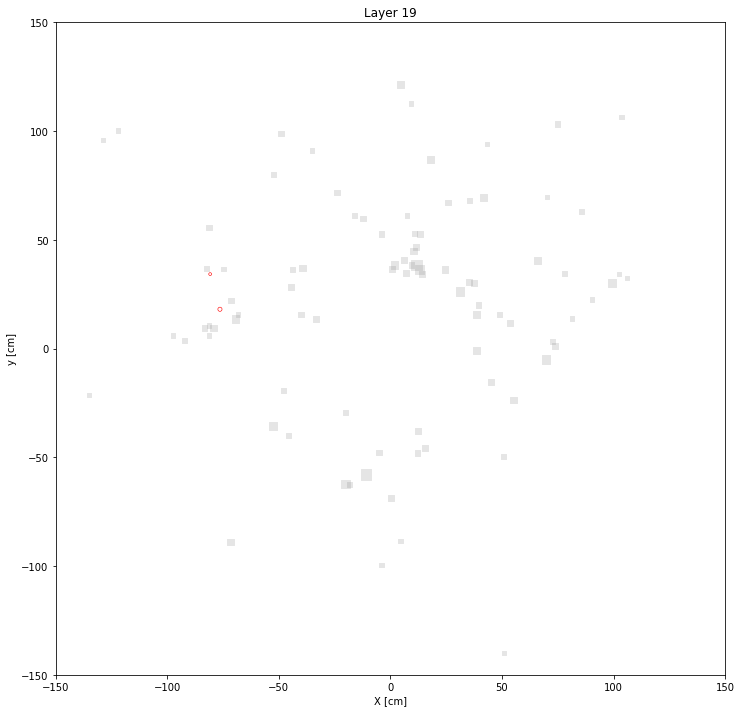

# layer 20, matched cells: 1


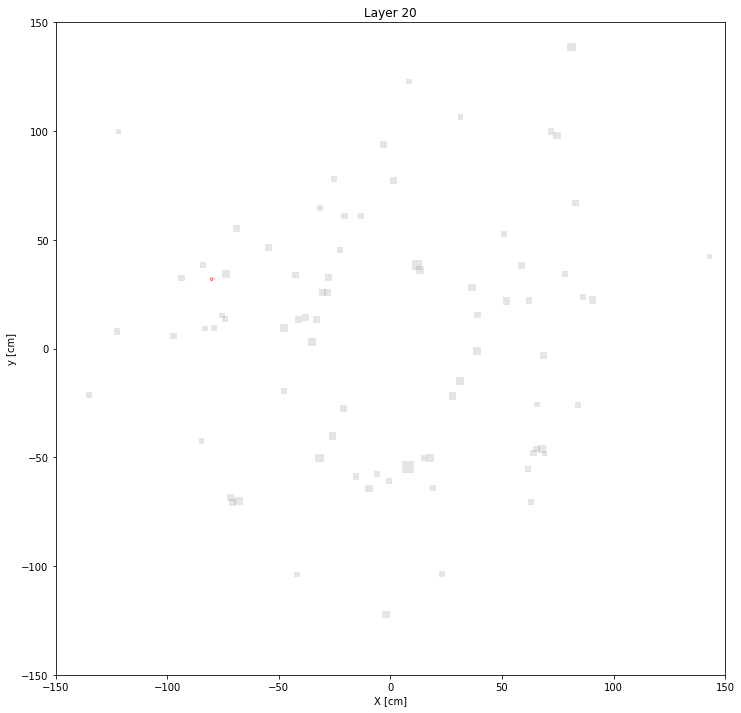

# layer 21, matched cells: 1


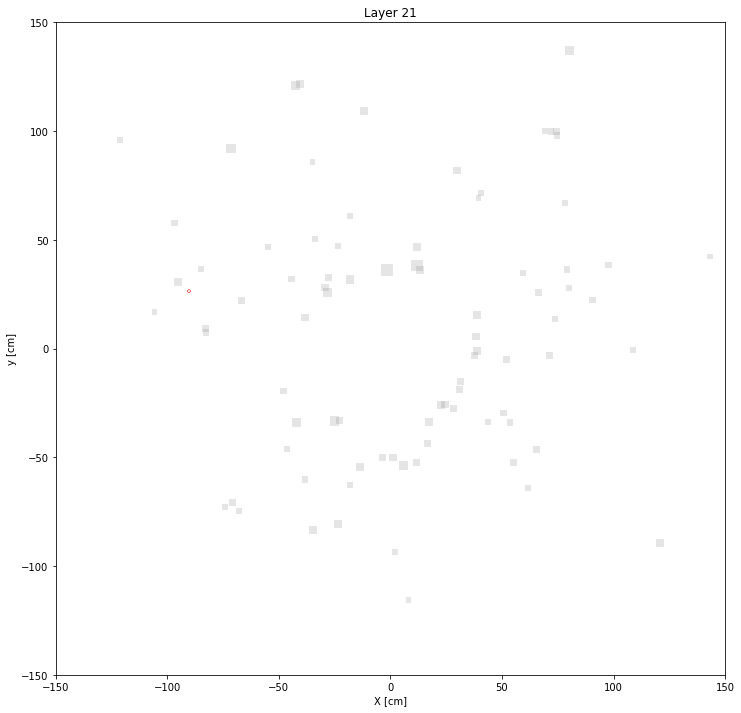

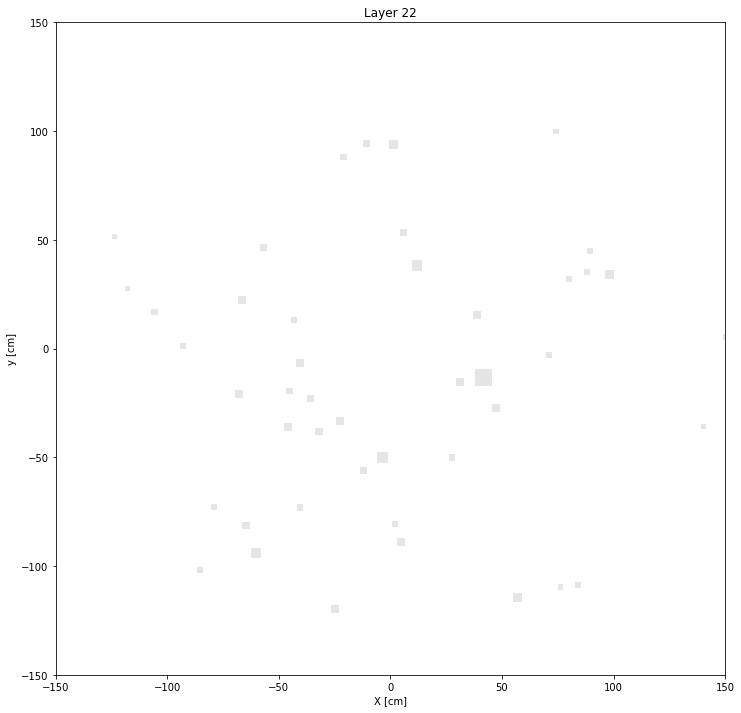

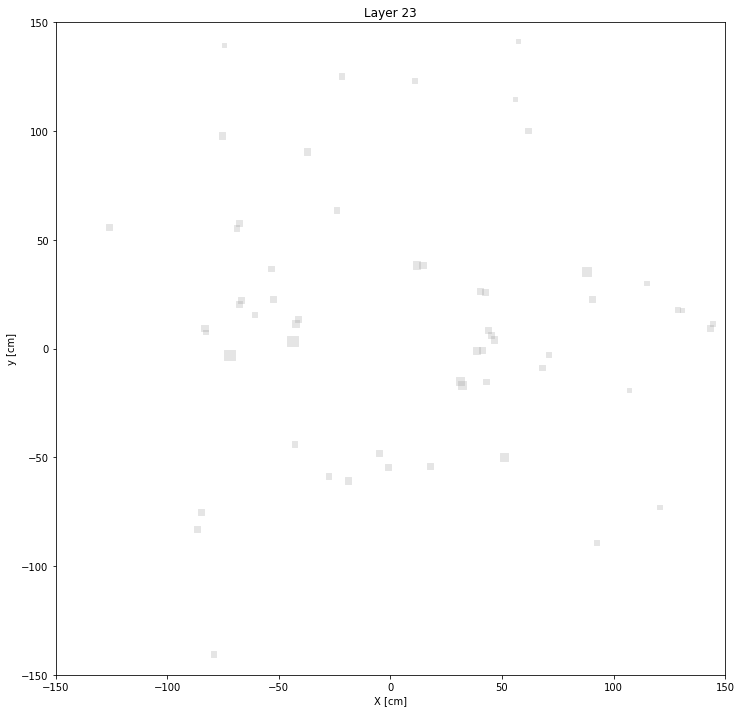

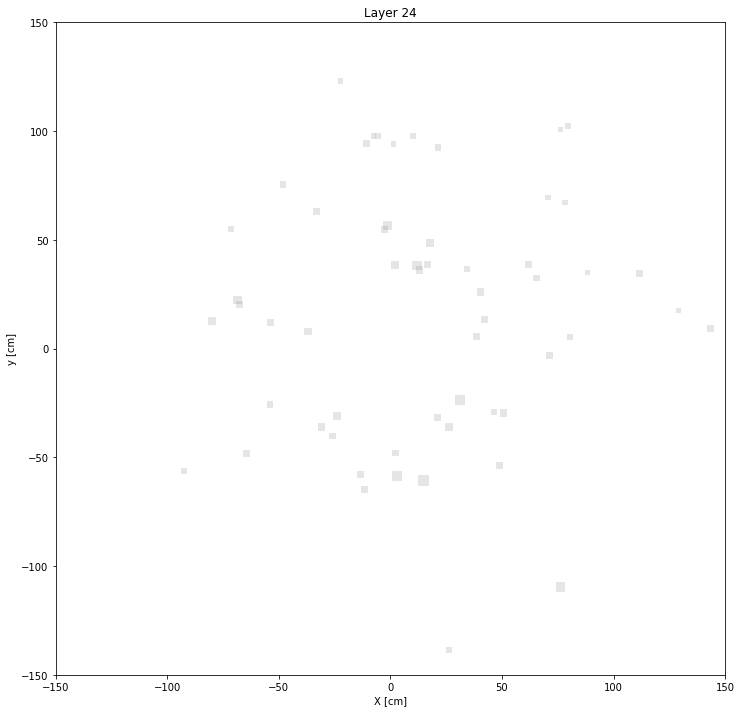

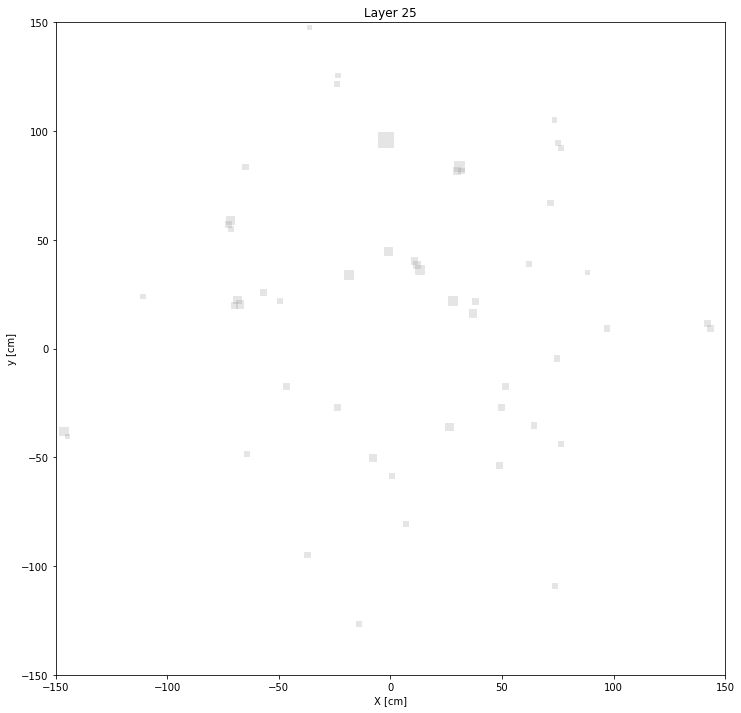

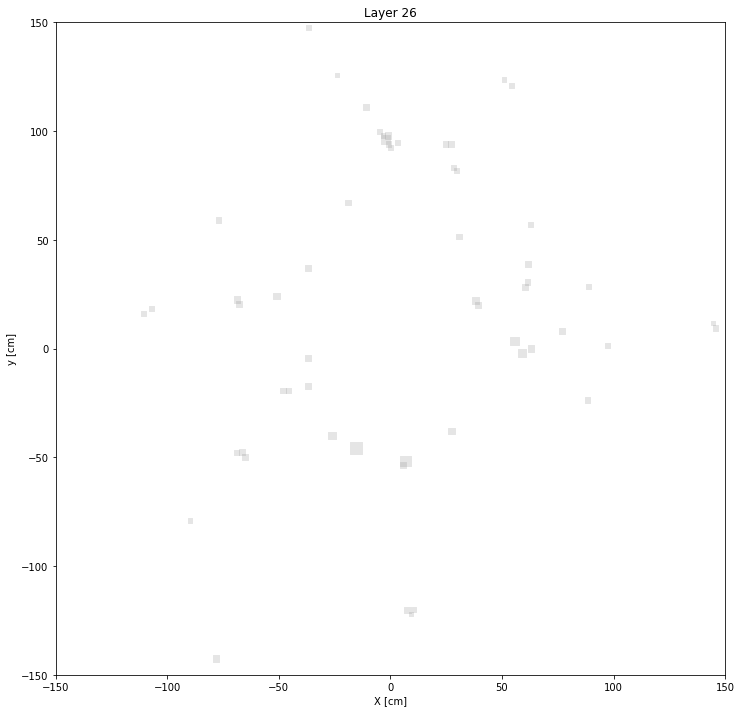

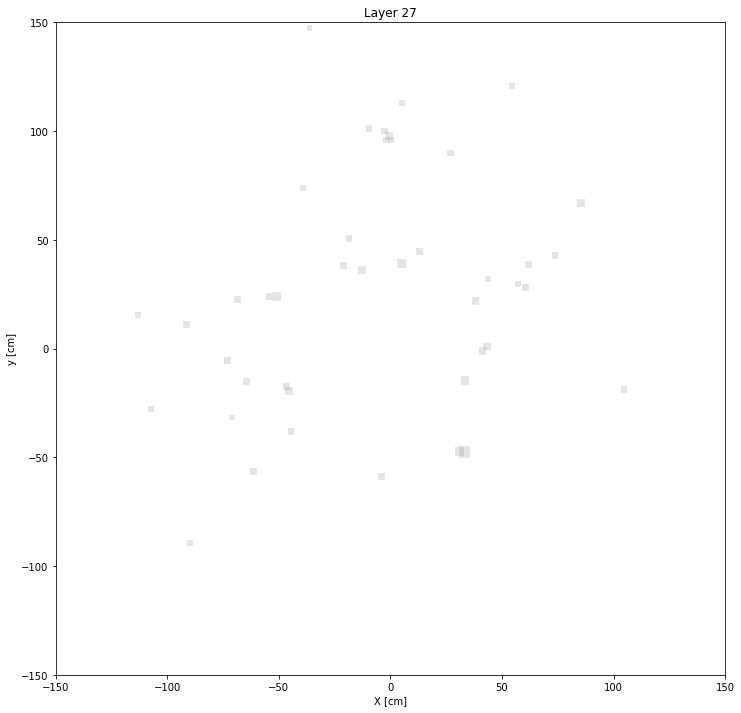

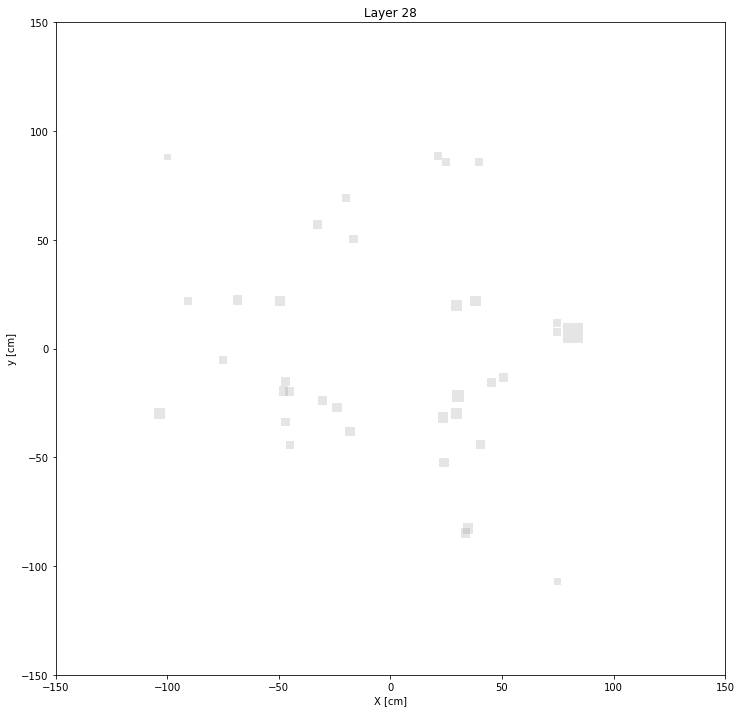

In [17]:
zside = 1
for layer in range(1,29):
    plotLayer(layer, zside, tcs, cl2d, mcl2d)


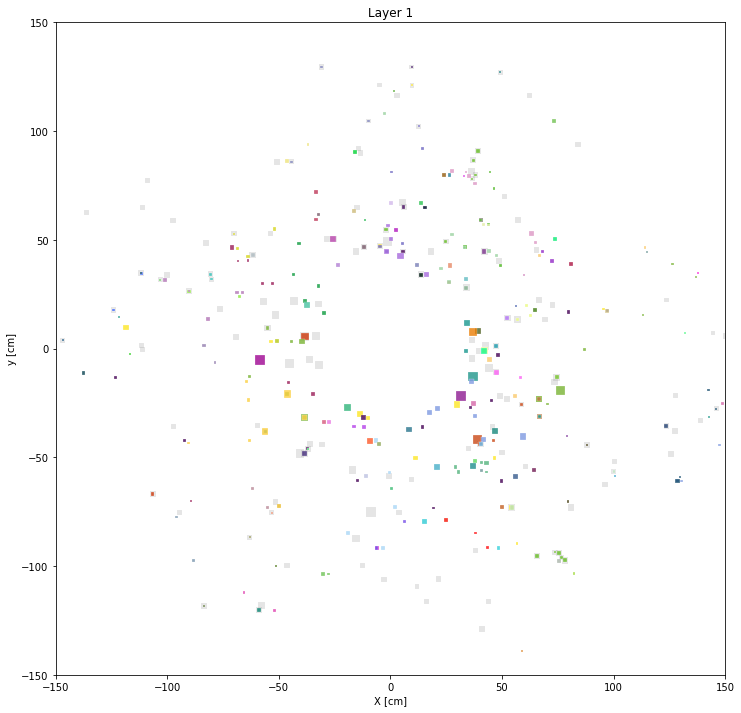

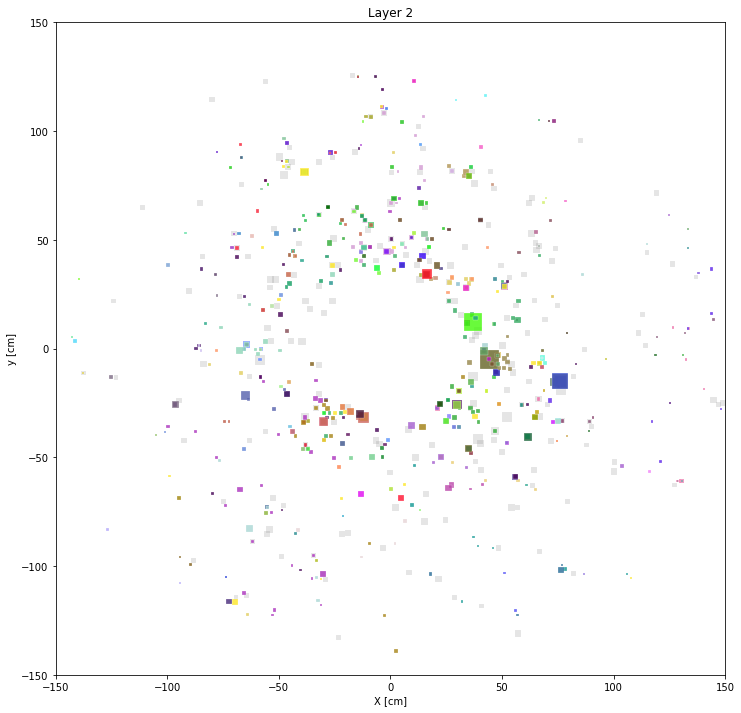

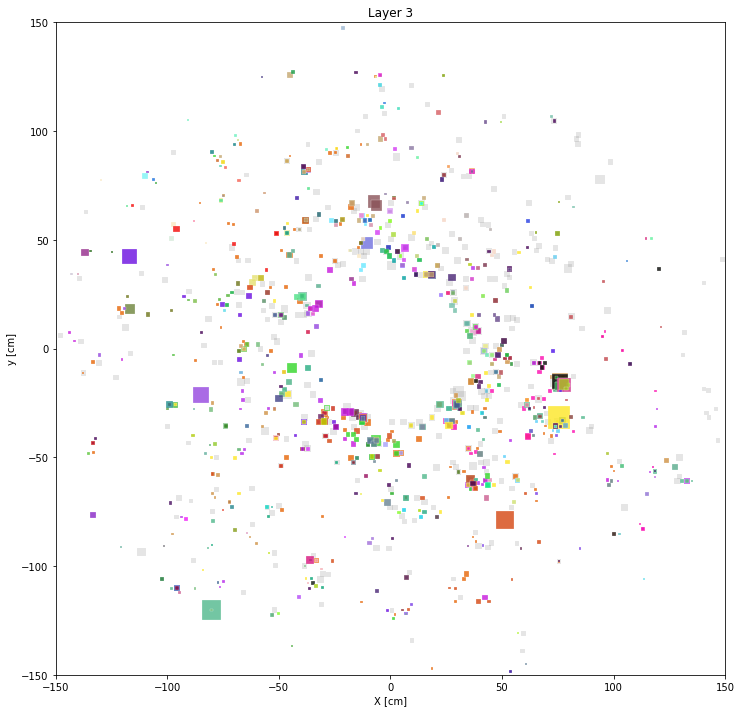

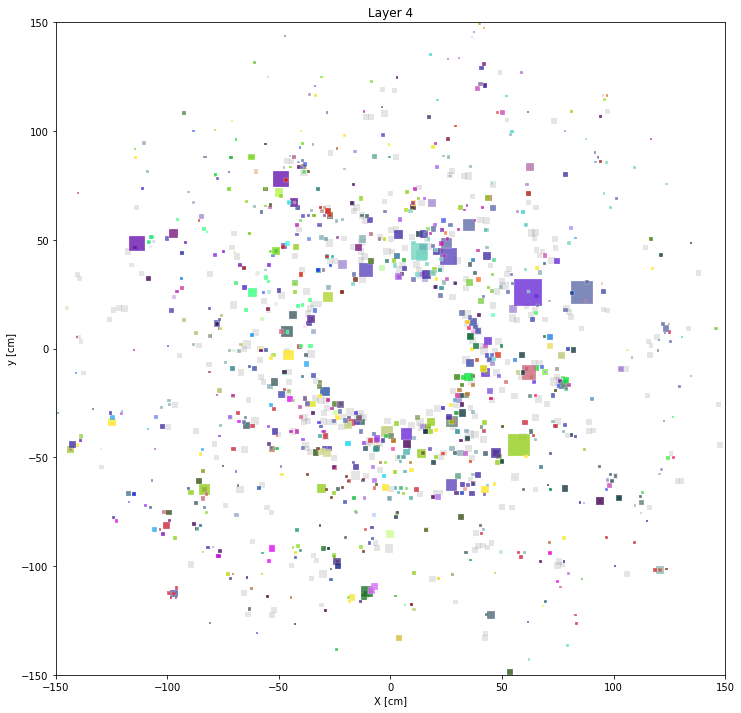

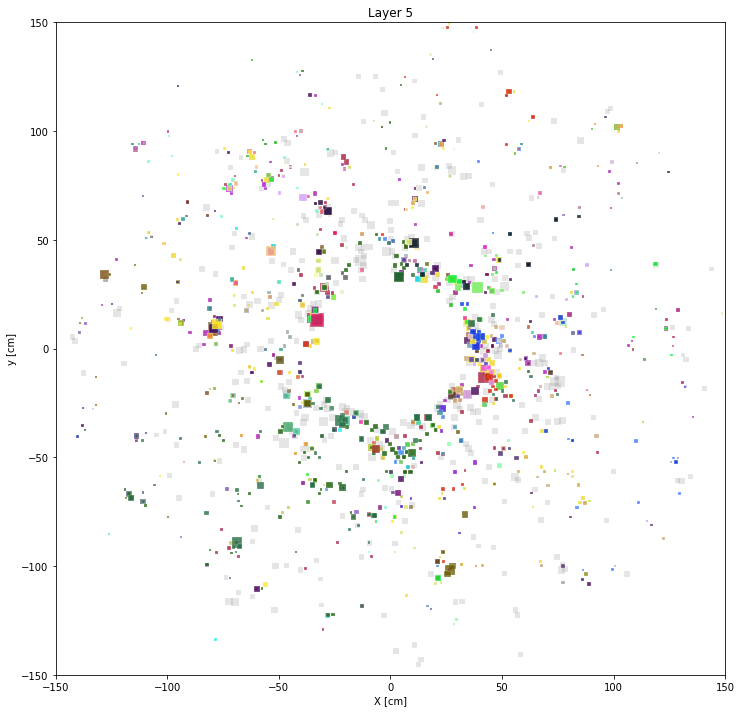

...

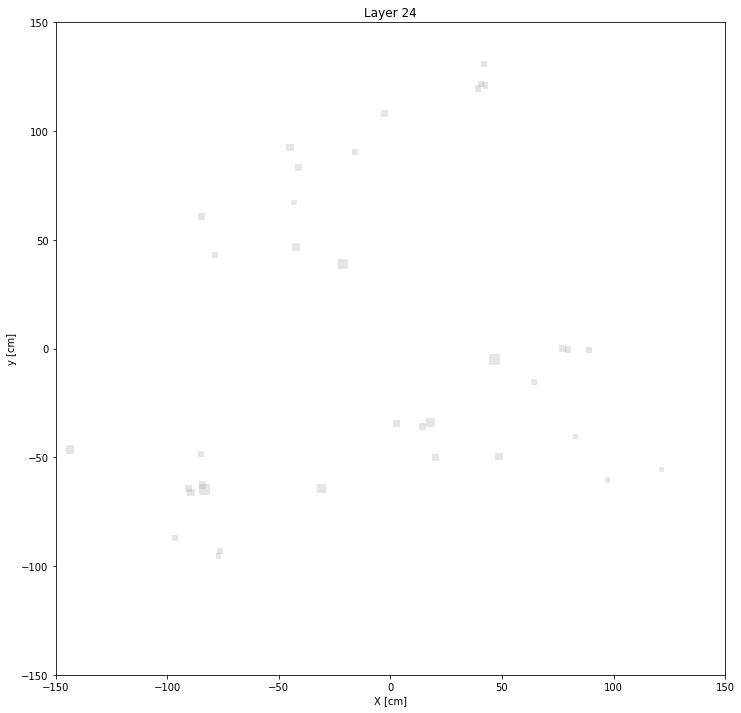

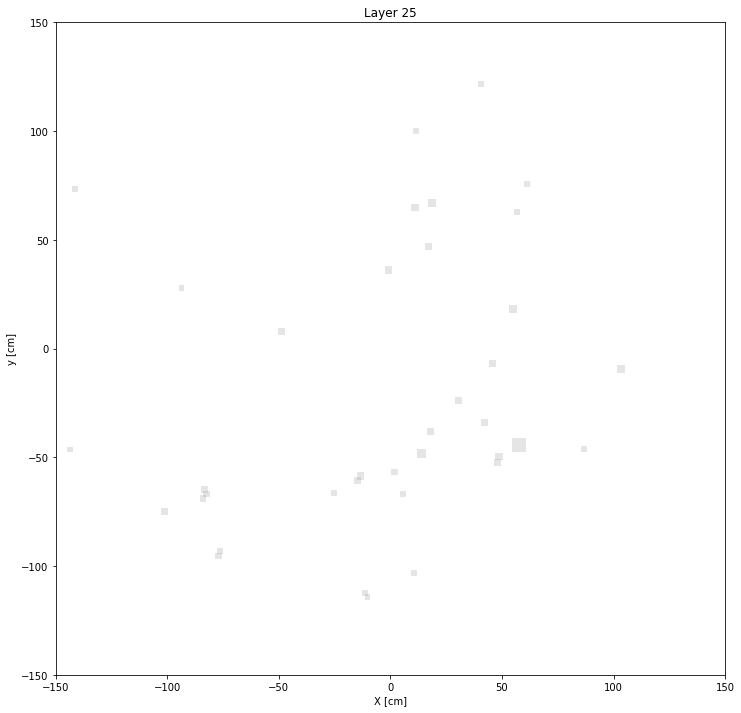

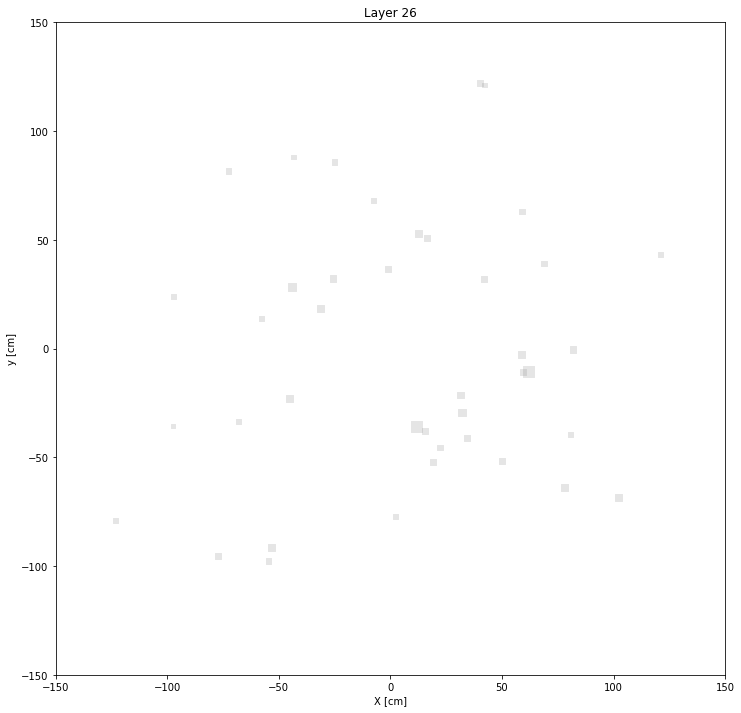

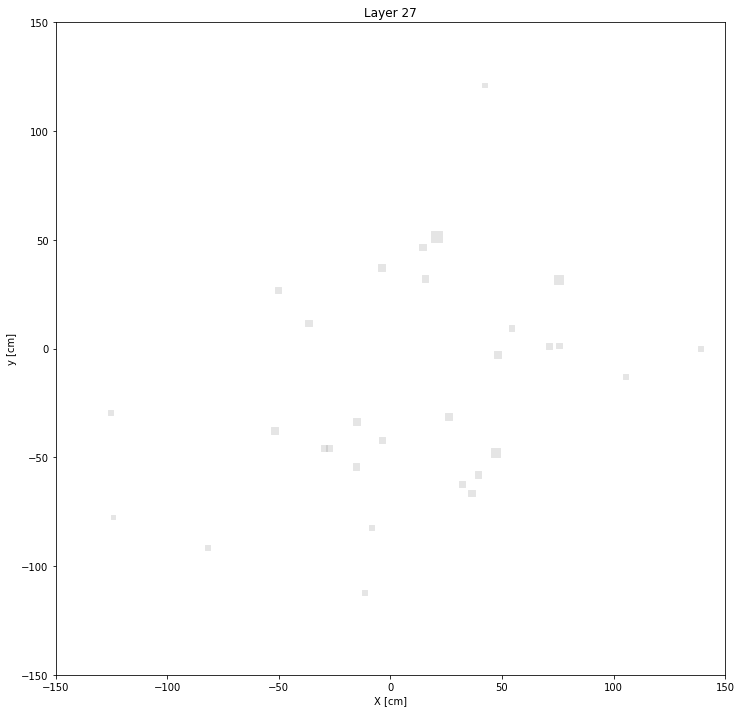

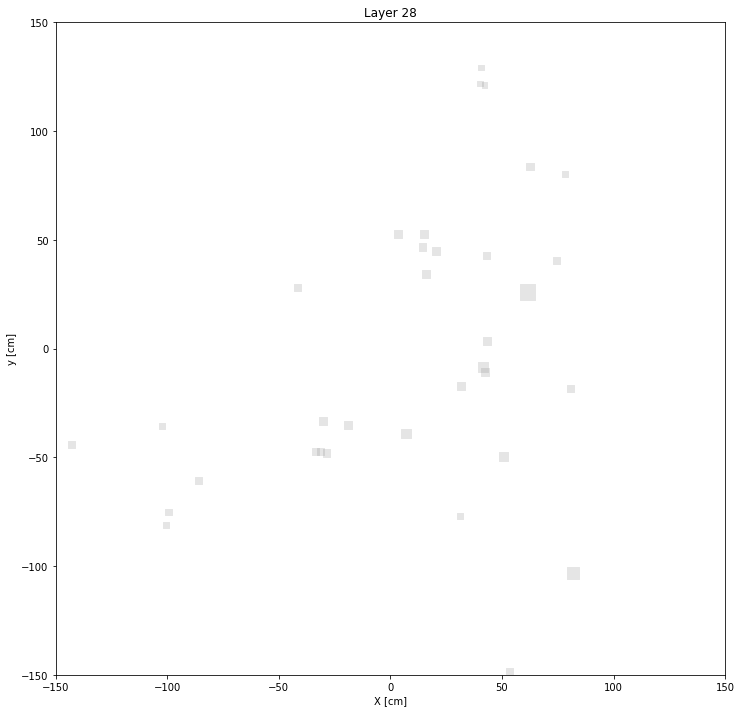

In [18]:
zside = -1
for layer in range(1,29):
    plotLayer(layer, zside, tcs, cl2d, mcl2d)

## DBSCAN 2D clusters

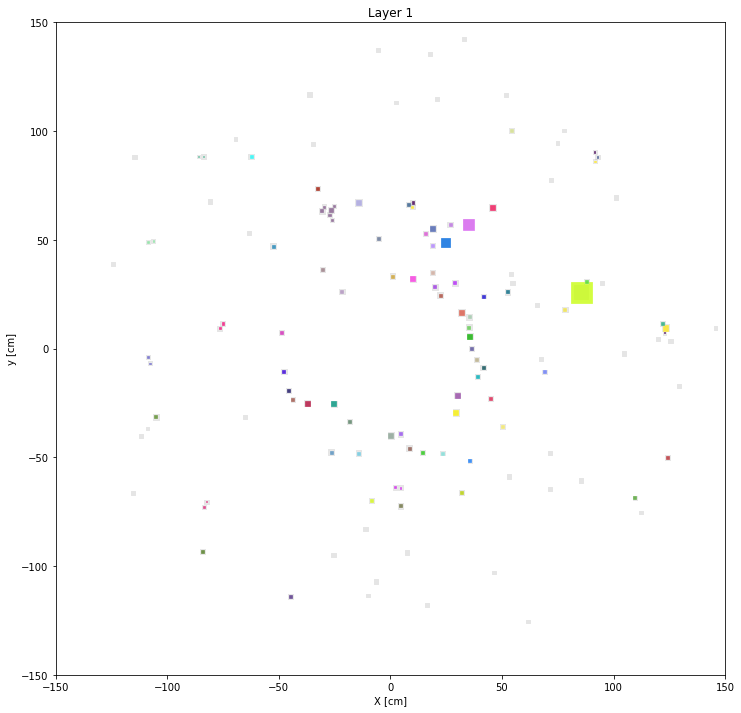

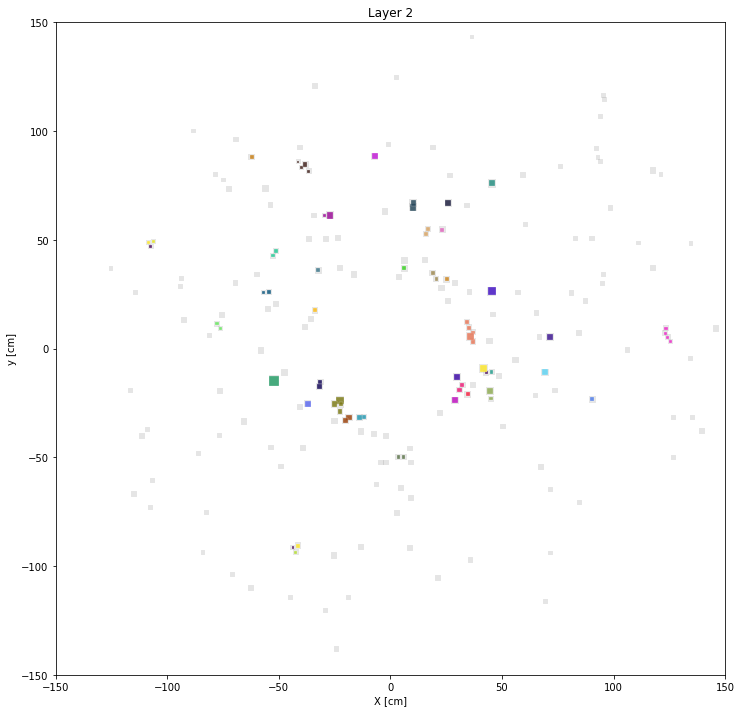

# layer 3, matched cells: 1


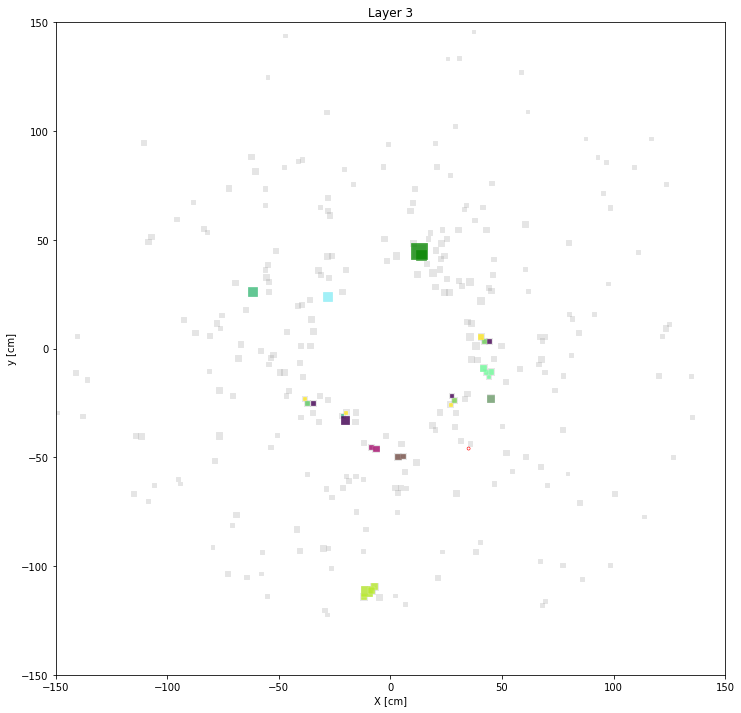

# layer 4, matched cells: 1


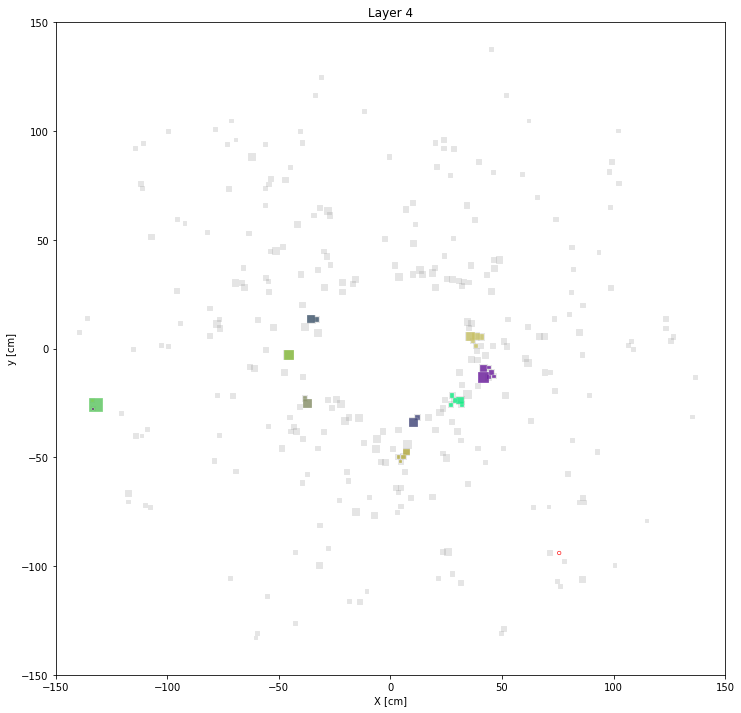

# layer 5, matched cells: 1


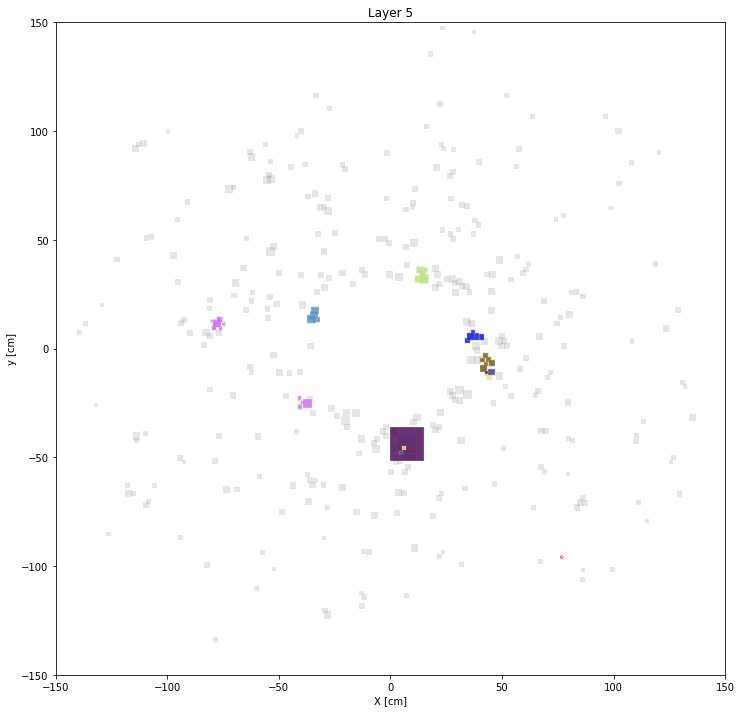

# layer 6, matched cells: 1


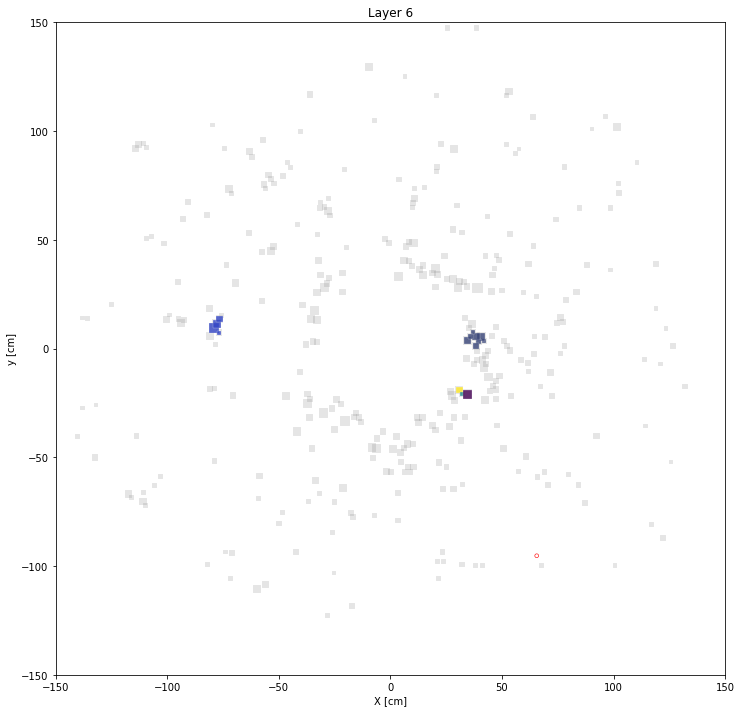

# layer 7, matched cells: 2


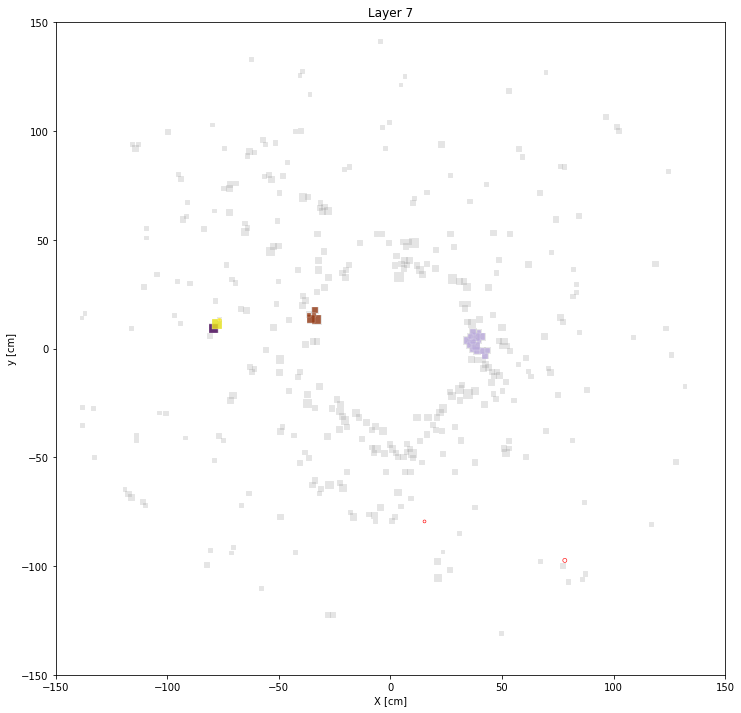

# layer 8, matched cells: 3


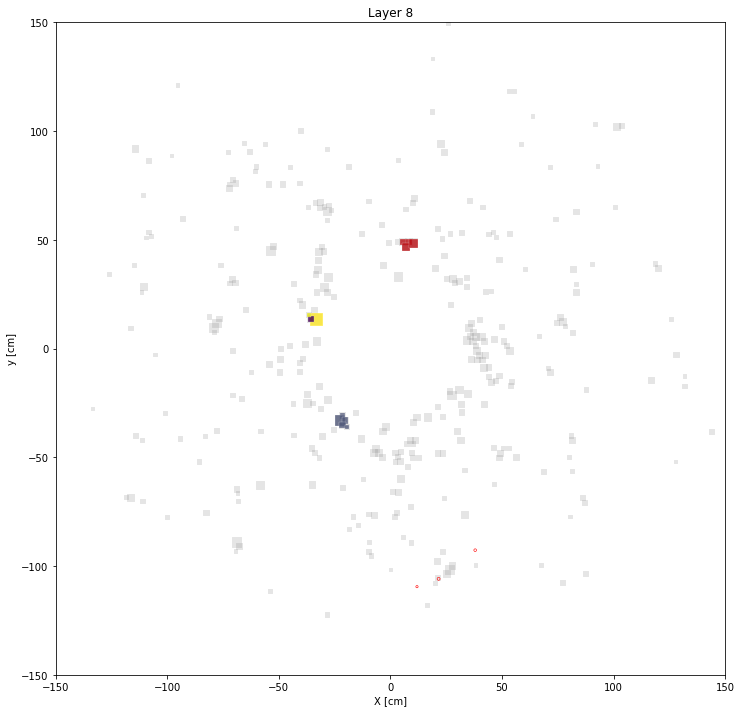

# layer 9, matched cells: 3


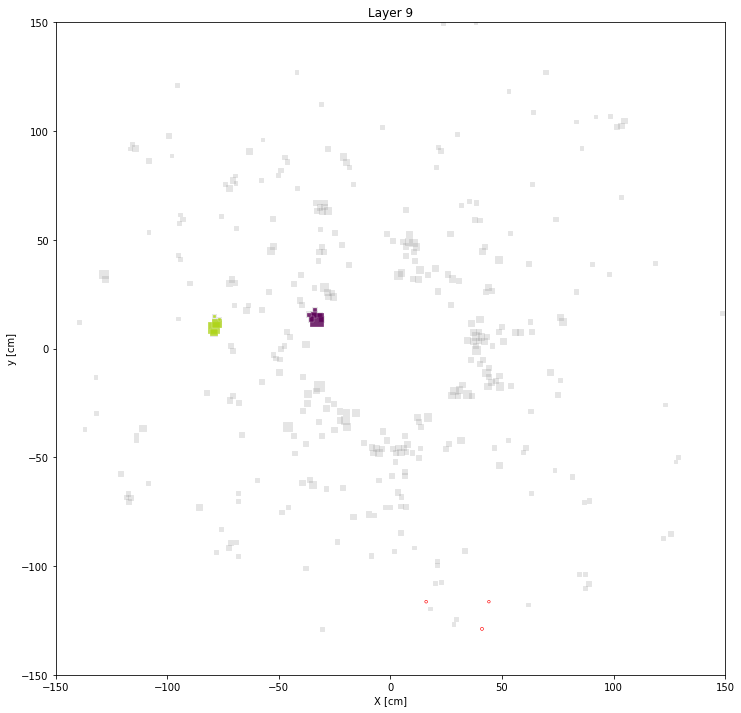

# layer 10, matched cells: 4


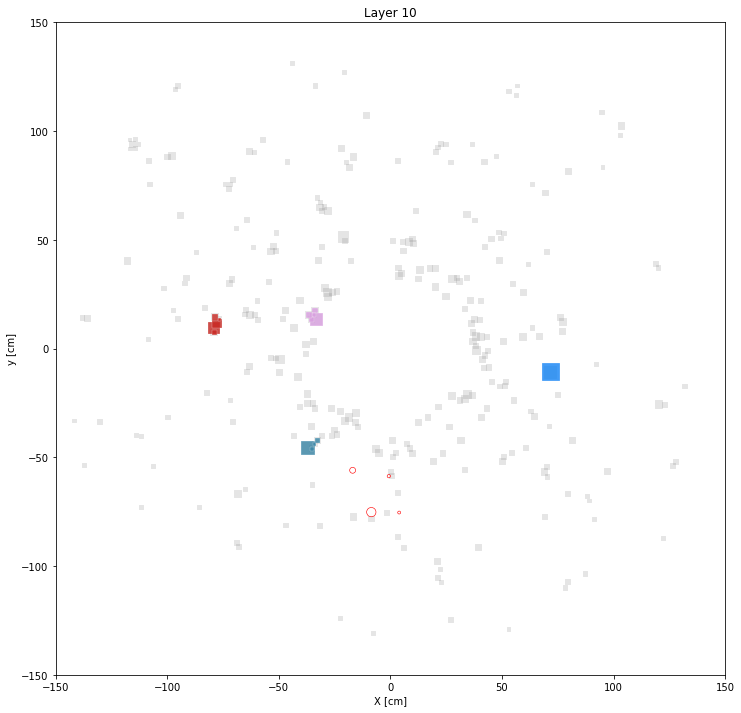

# layer 11, matched cells: 4


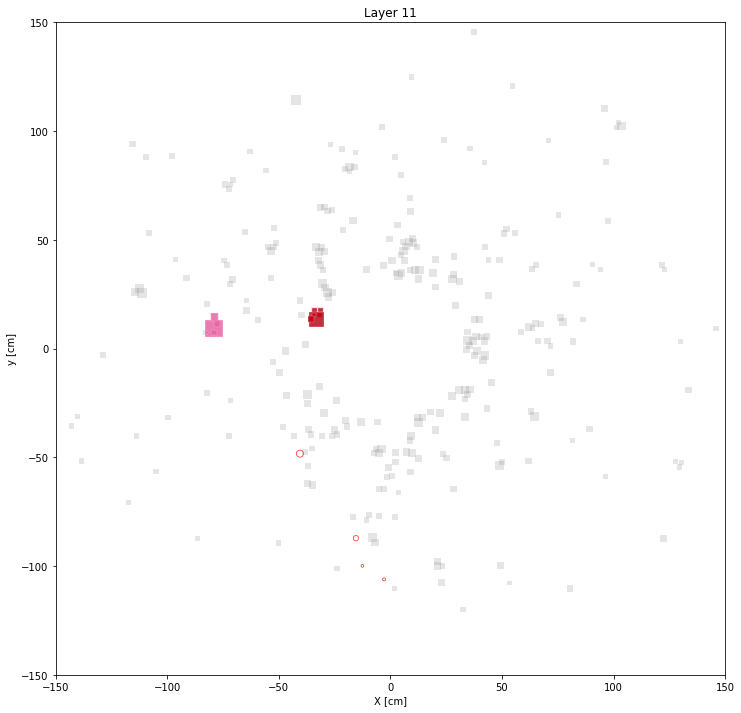

# layer 12, matched cells: 4


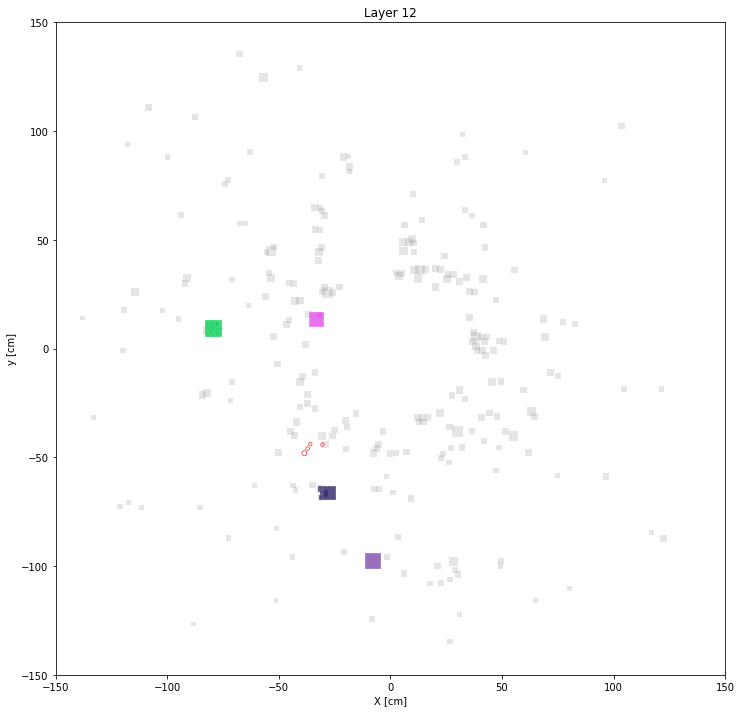

# layer 13, matched cells: 3


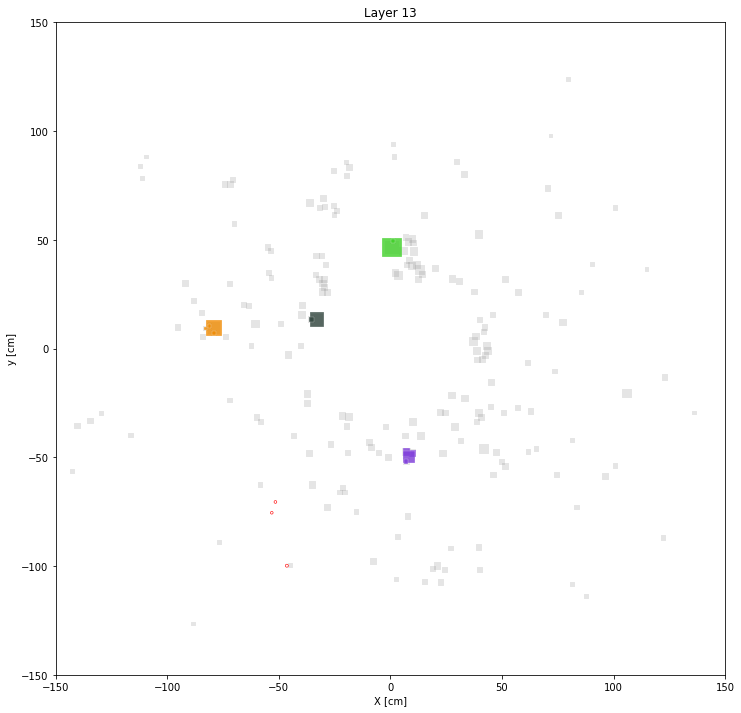

# layer 14, matched cells: 2


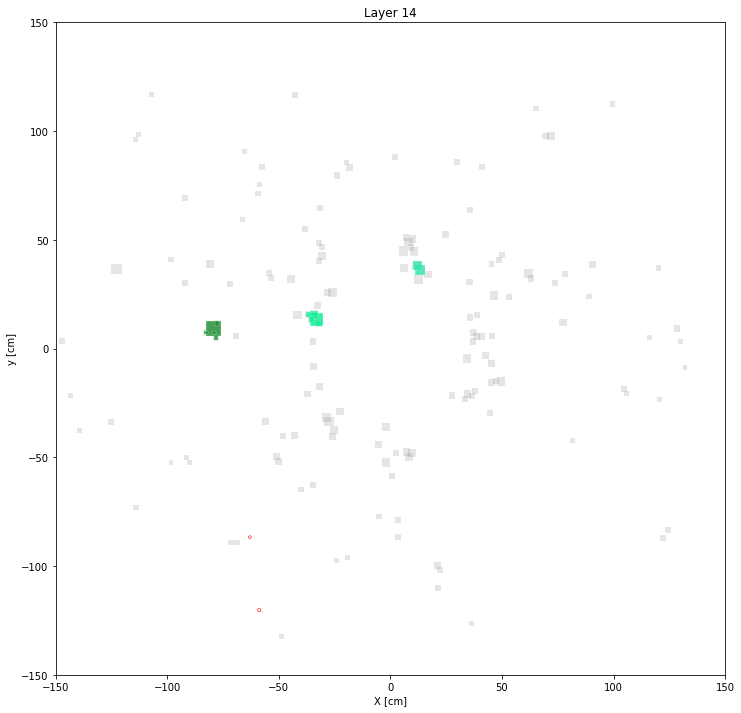

# layer 15, matched cells: 3


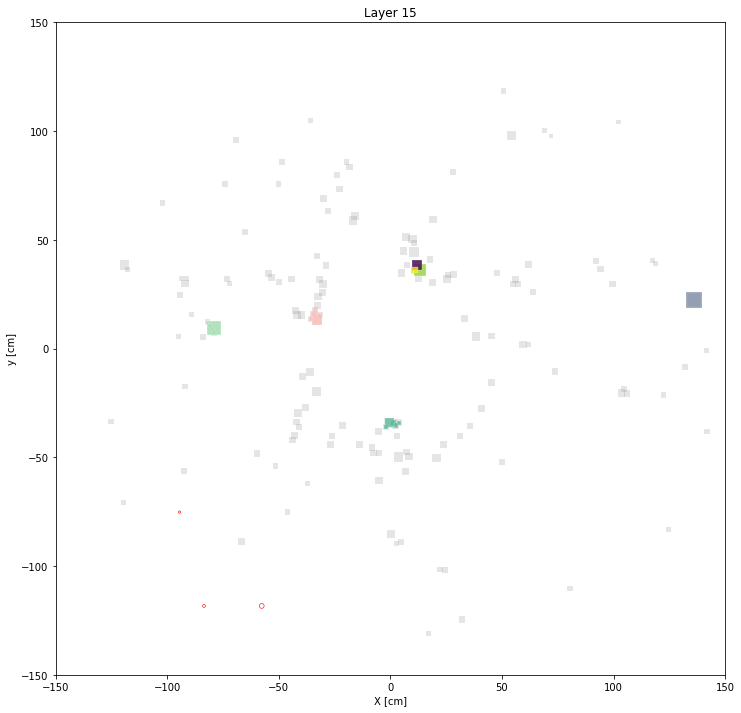

# layer 16, matched cells: 3


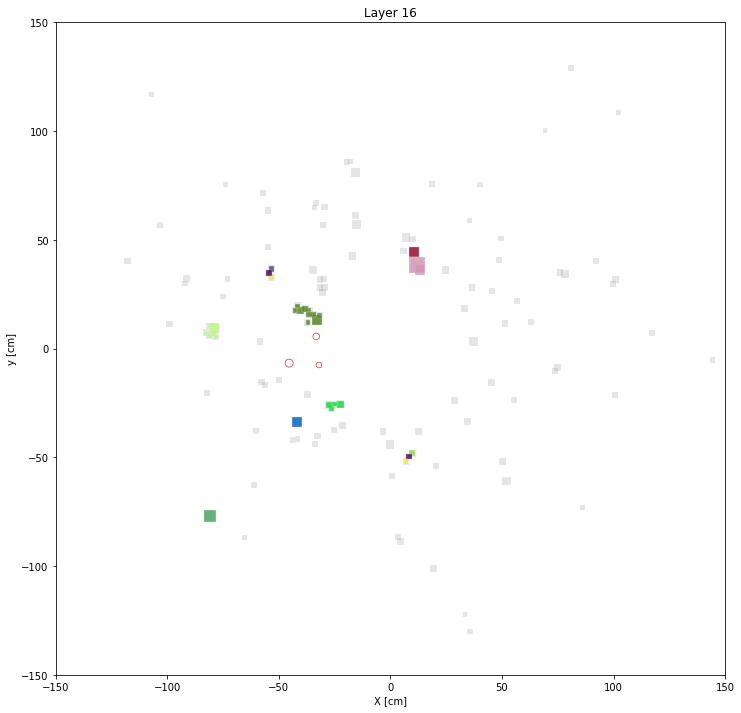

# layer 17, matched cells: 4


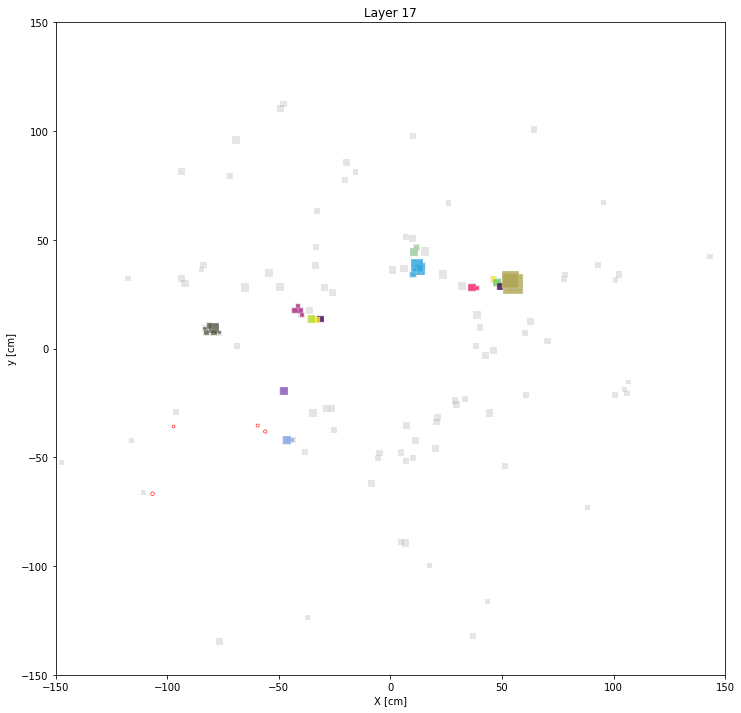

# layer 18, matched cells: 4


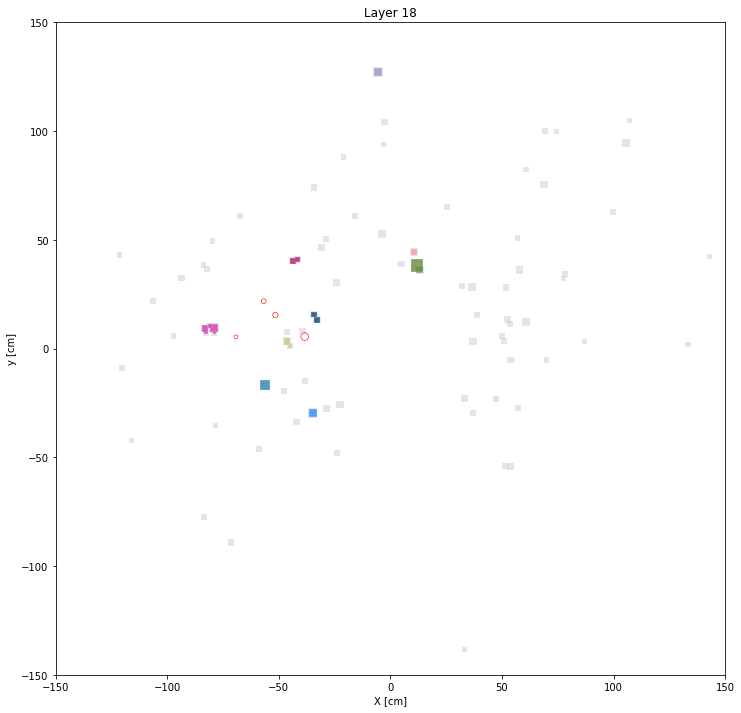

# layer 19, matched cells: 2


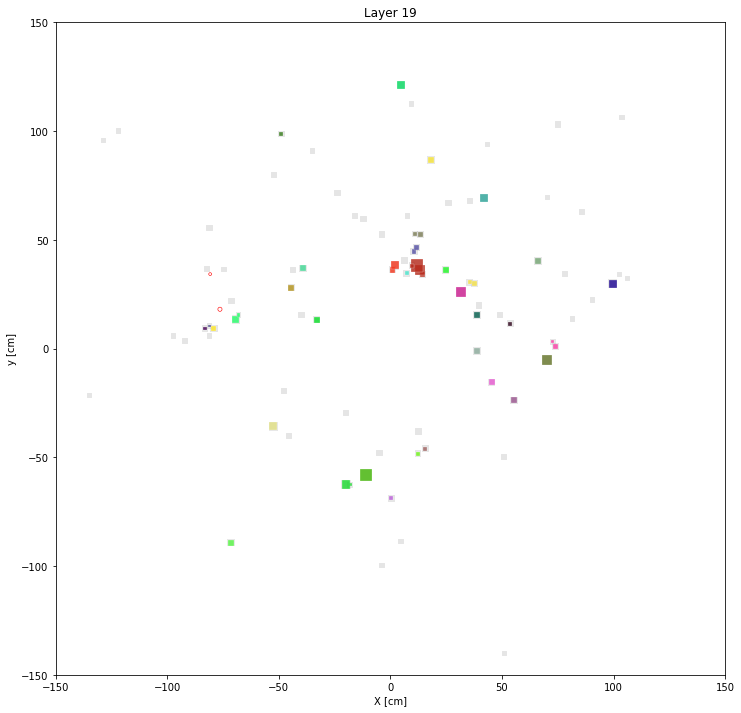

# layer 20, matched cells: 1


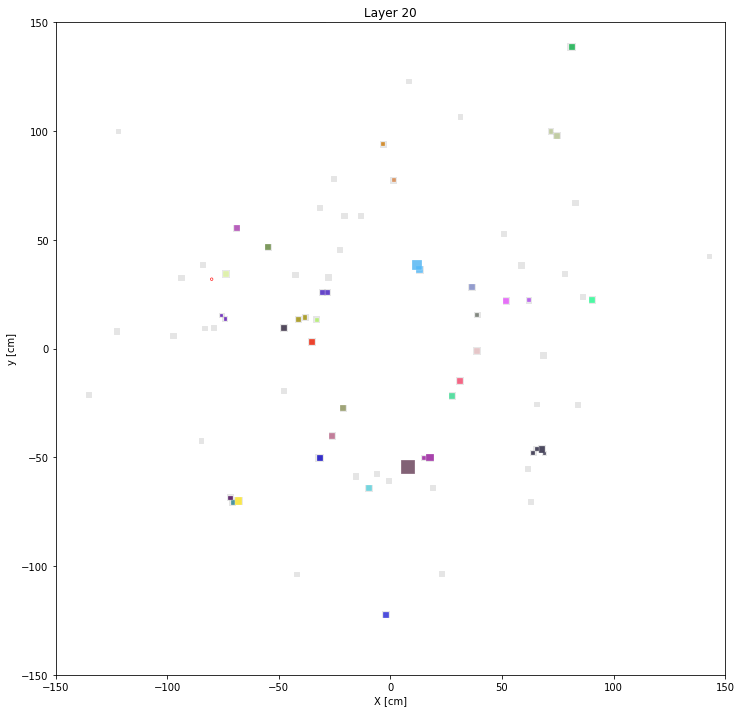

# layer 21, matched cells: 1


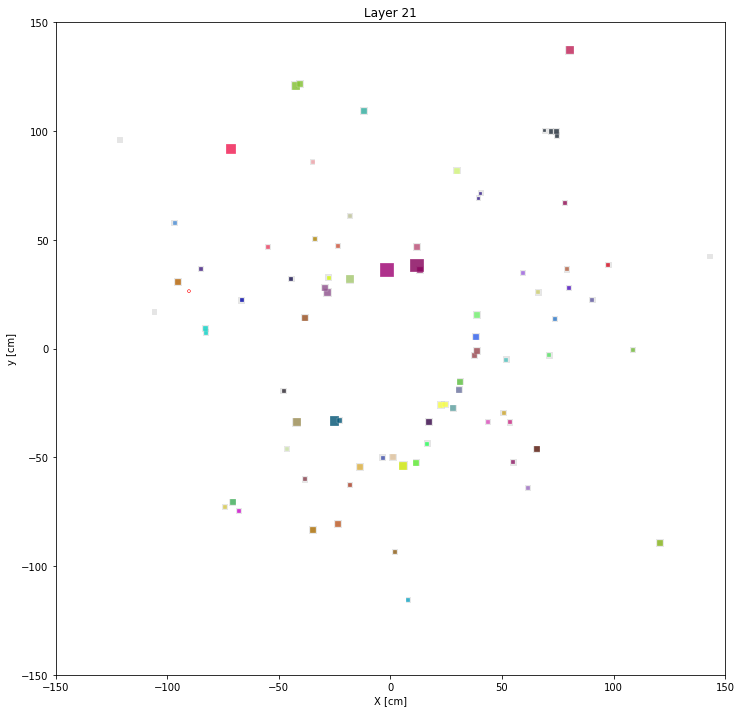

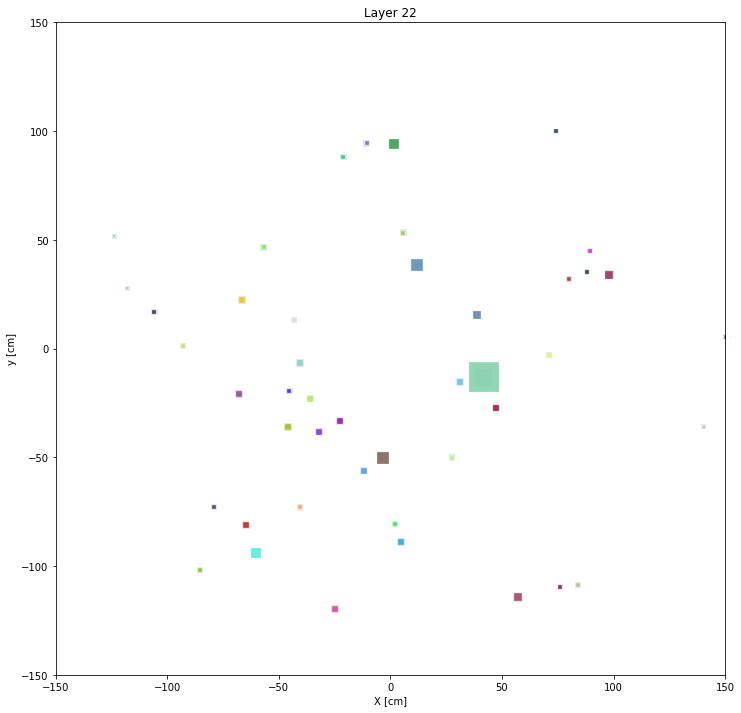

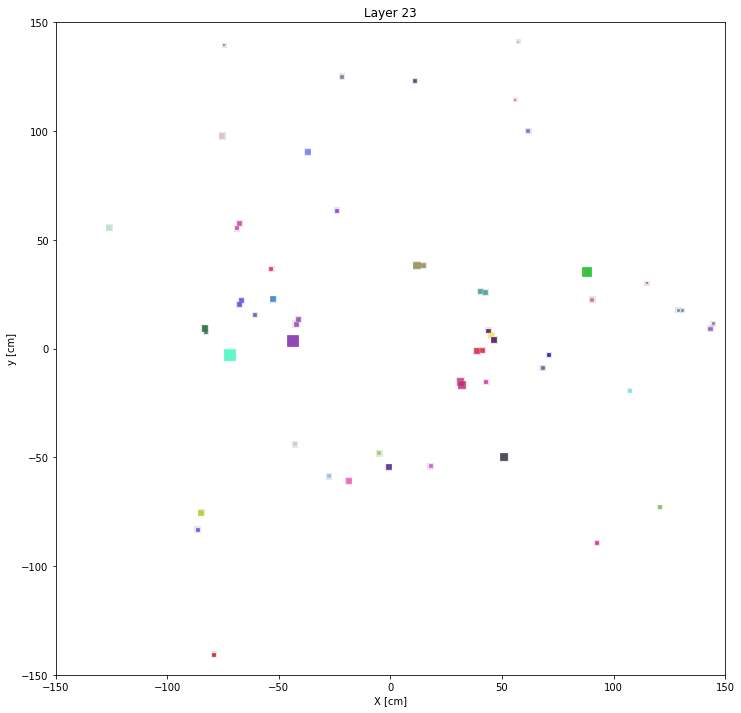

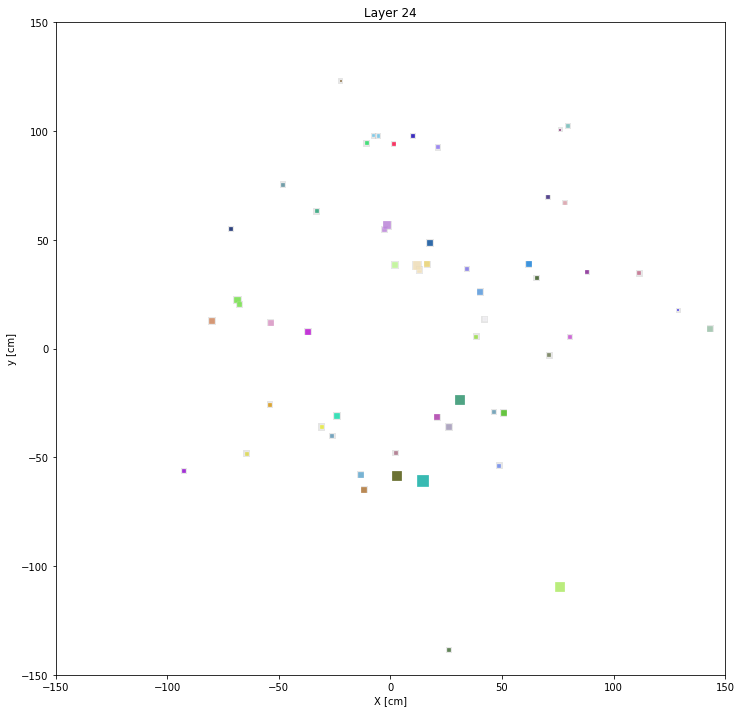

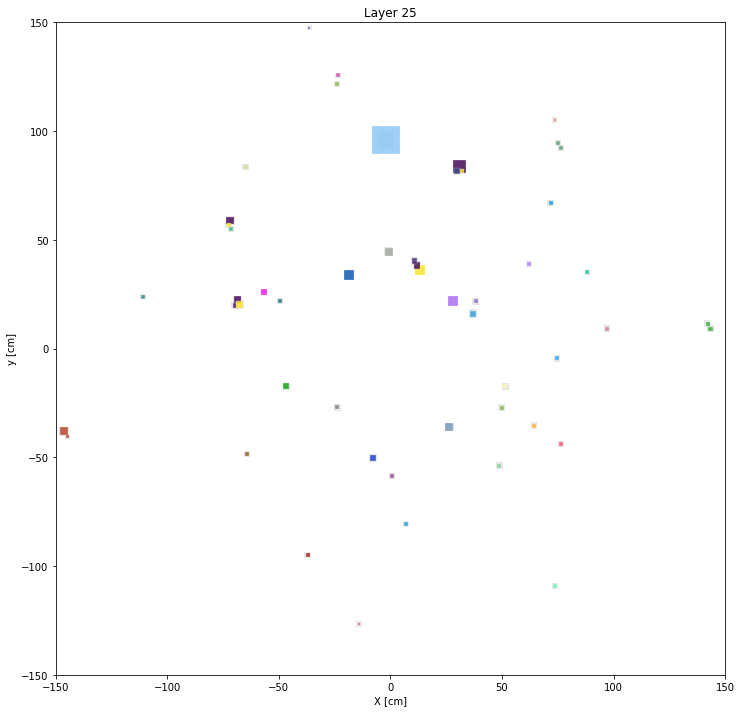

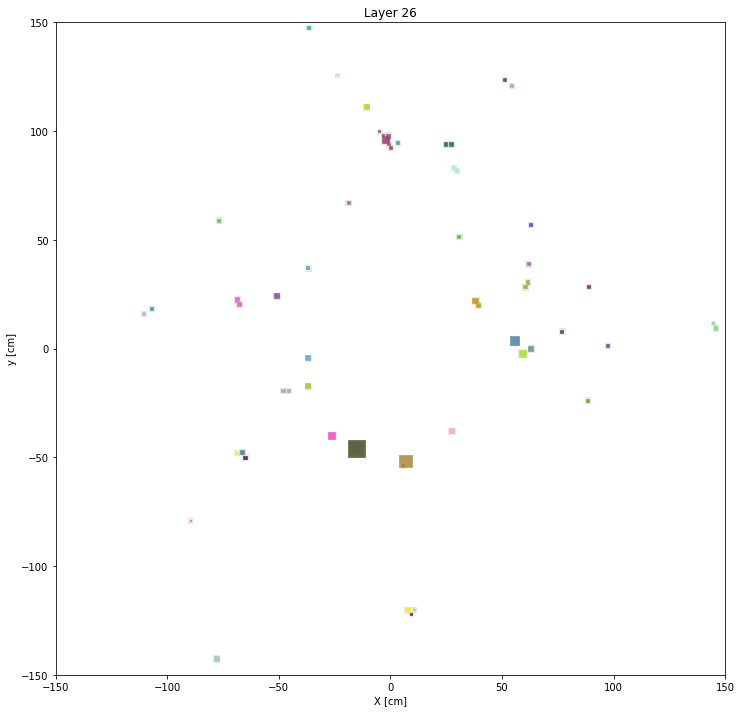

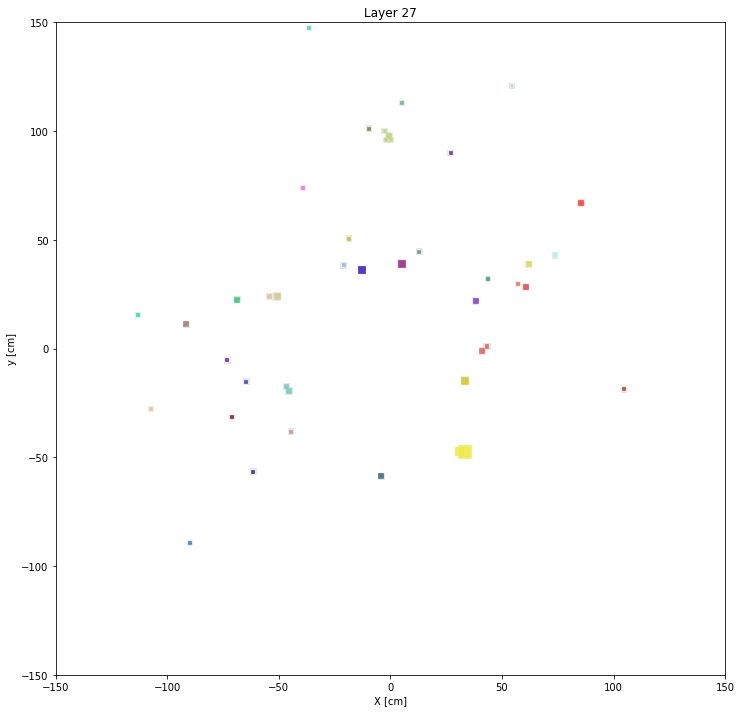

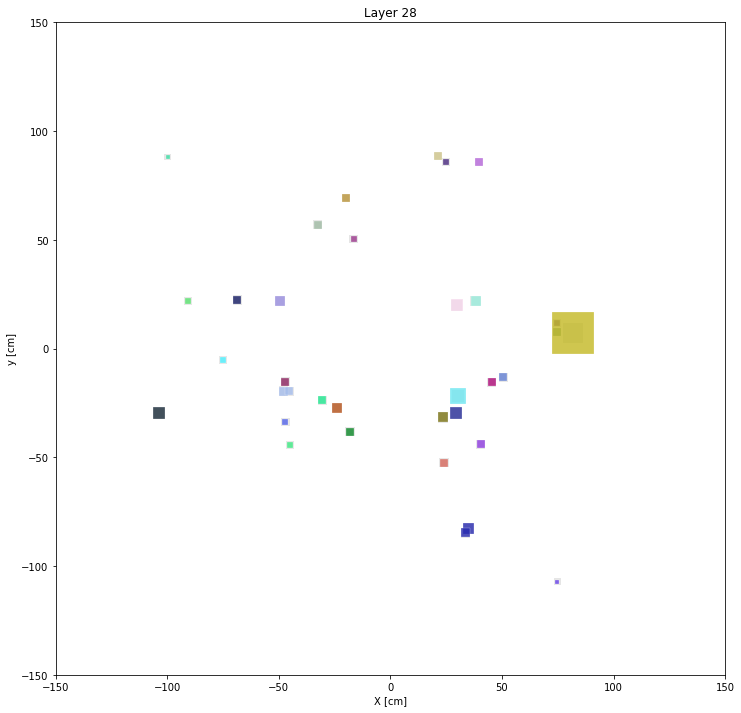

In [19]:
zside = 1
for layer in range(1, 29):
    plotLayer(layer, zside, tcs, new2Dcls, mcl2d)

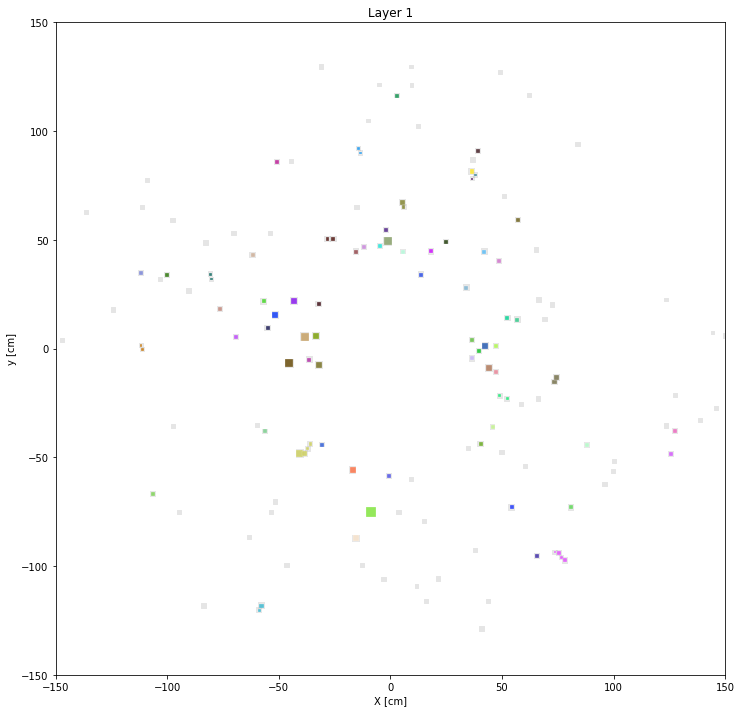

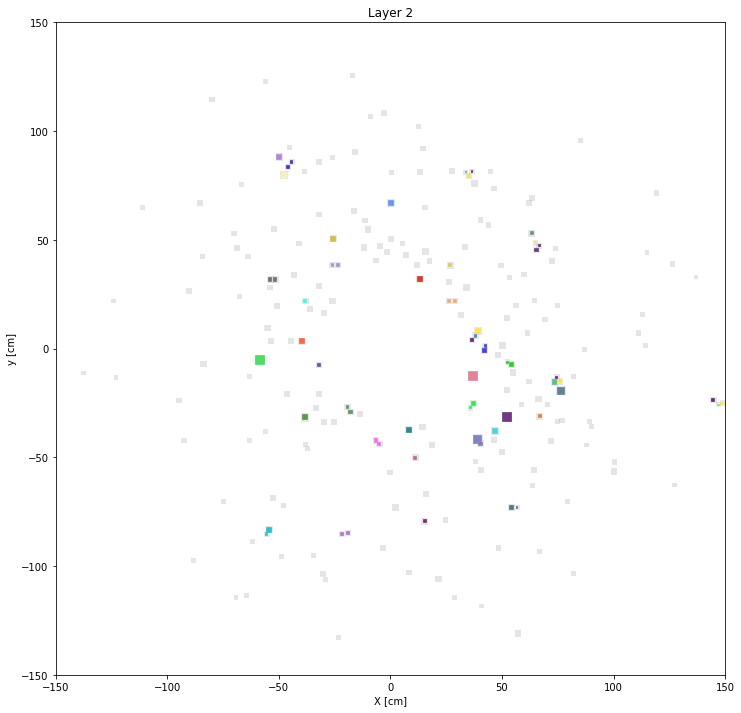

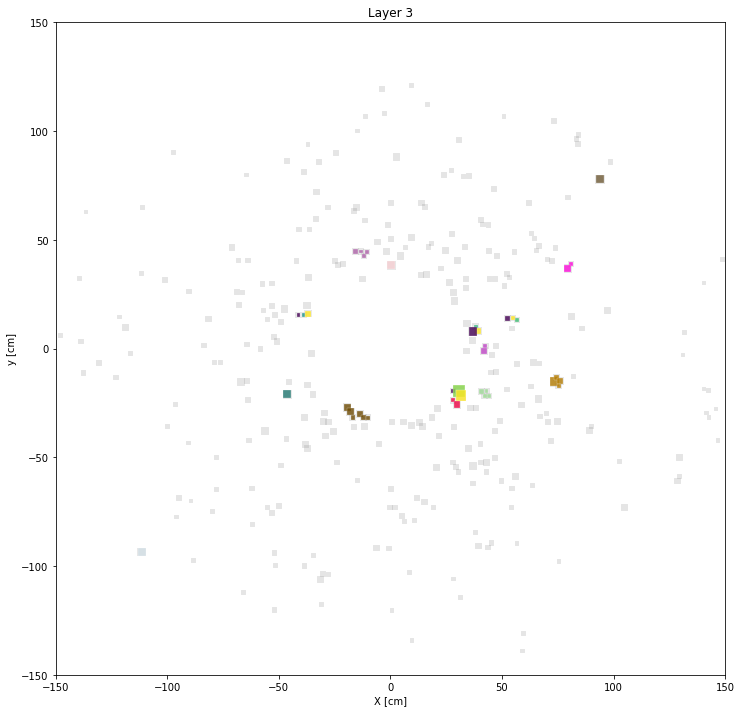

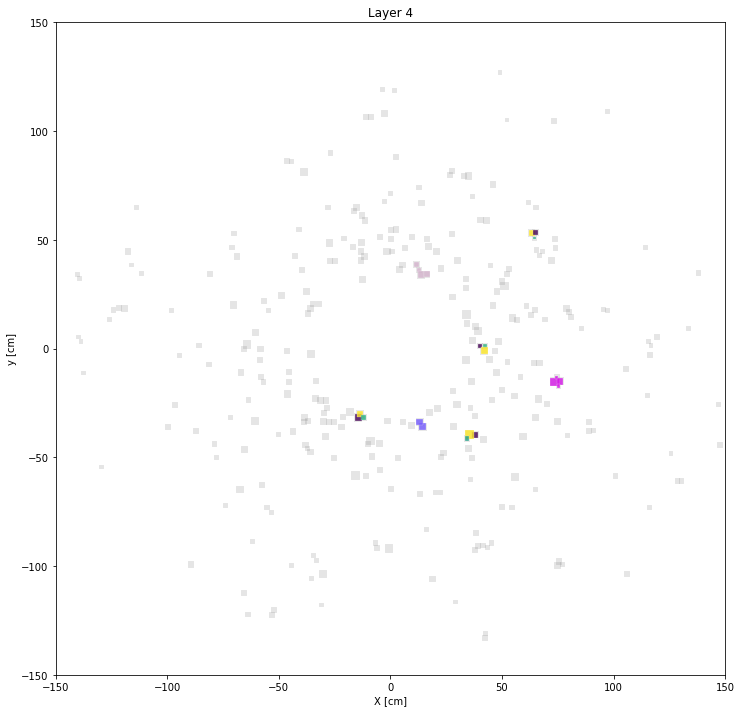

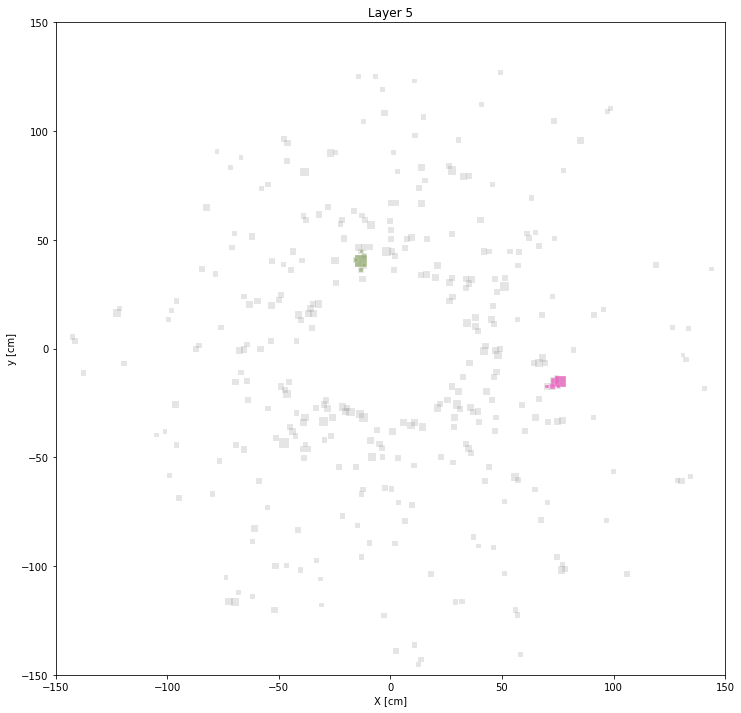

...

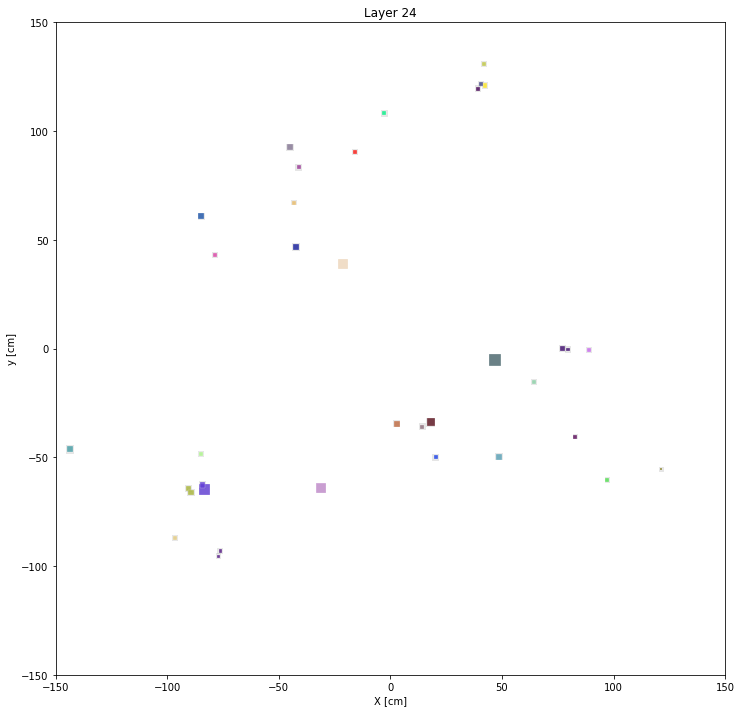

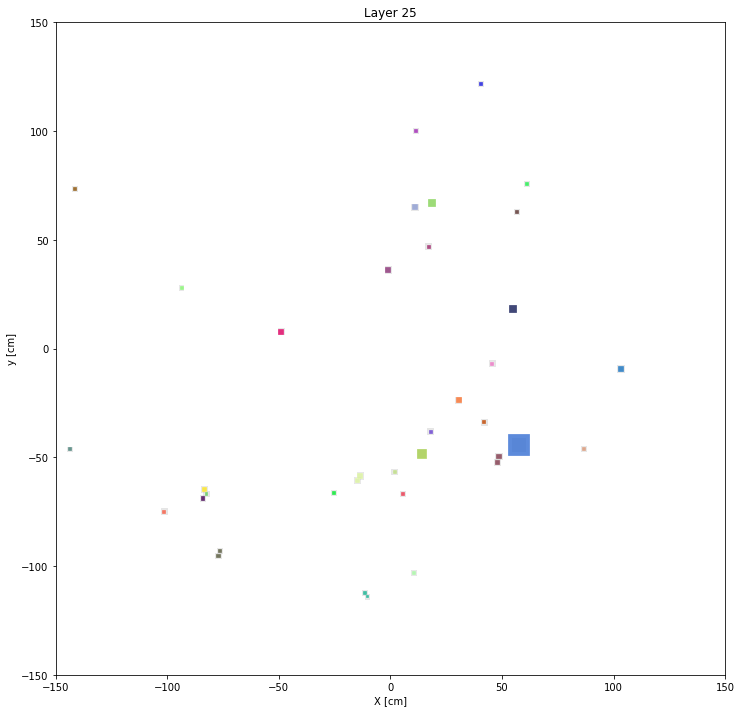

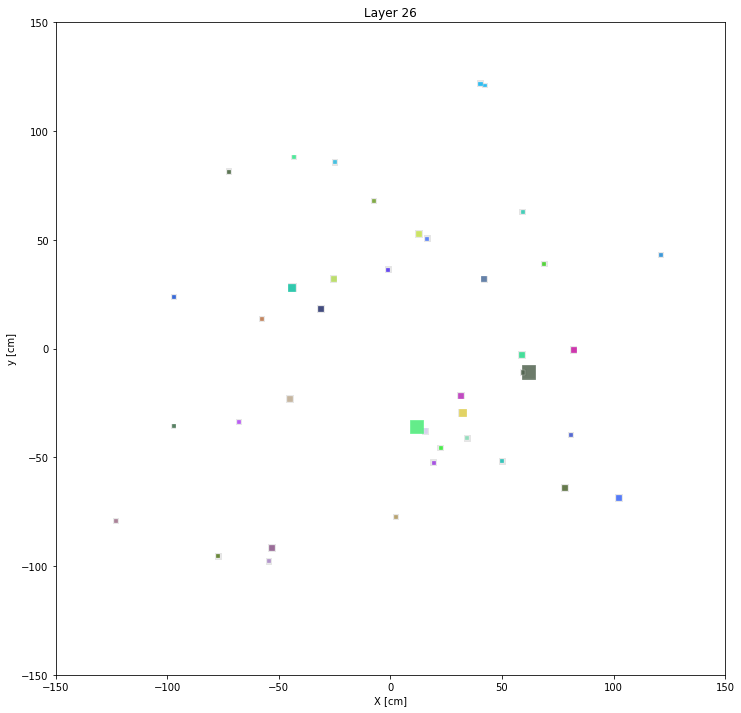

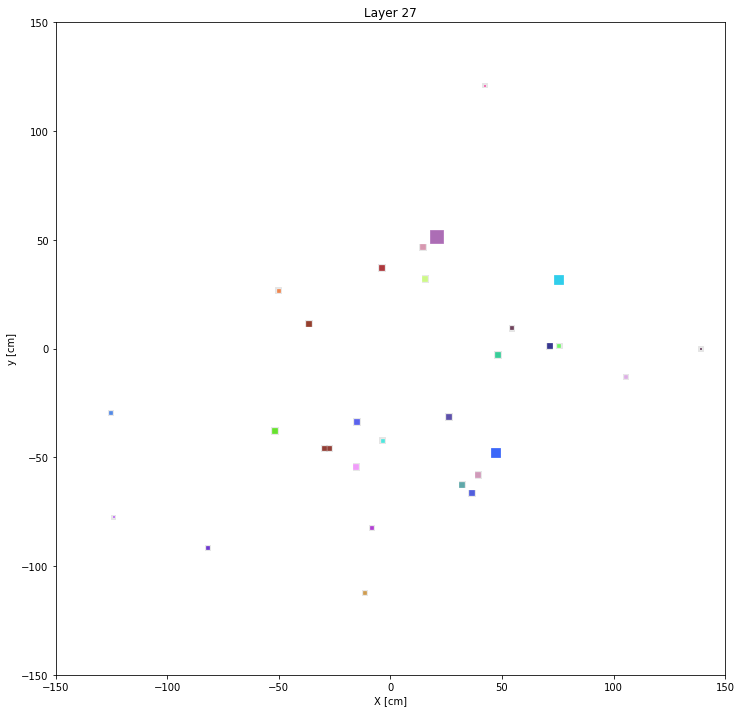

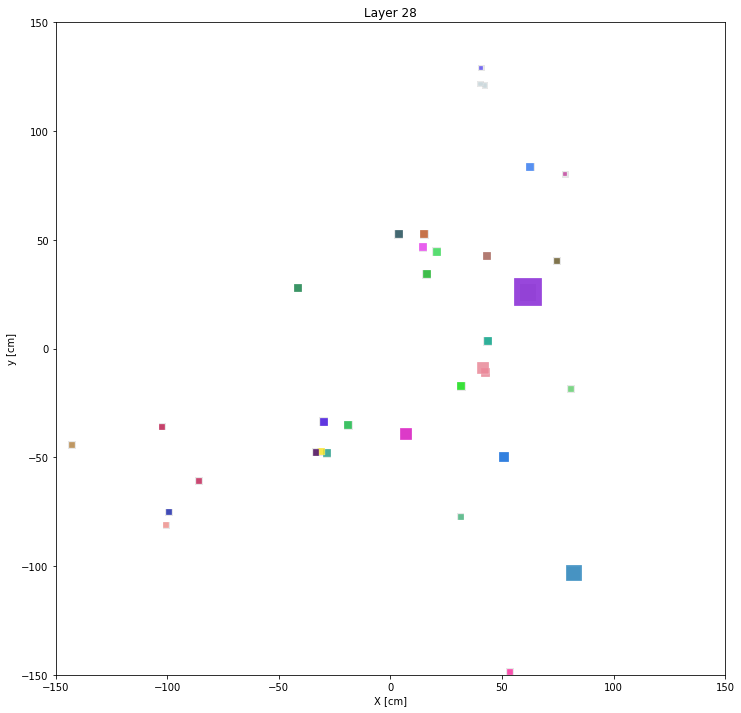

In [20]:
zside = -1

for layer in range(1, 29):
    plotLayer(layer, zside, tcs, new2Dcls, mcl2d)


In [21]:
def plotProj3DClusters(cl2d, cl3d):
    plt.figure(figsize=(12,12))
    plt.title('Projected 3D clusters')
    
    plt.scatter(cl2d['x'], cl2d['y'], label='all', marker="s", c="tab:gray",edgecolor="w",linewidth=0.3,
            s=100*cl2d['energy']**0.5,alpha = 0.2)
    for idx, cl in cl3d.iterrows():
        print '----------------'
        print cl
        print cl.clusters
        components = cl2d.loc[cl.clusters]
        print components
        plt.scatter(components['x'], components['y'], label='all', marker="s", c=cl.color,edgecolor="w",linewidth=0.3,
            s=100*components['energy']**0.5,alpha = 0.8)
     
    plt.xlabel("X [cm]")
    plt.ylabel("y [cm]")
        
    plt.xlim([-150,150])
    plt.ylim([-150,150])
    #plt.xlim([30,40])
    #plt.ylim([20,30])
    plt.show()
    

In [22]:
def plotProj3DClustersEtaPhi(cl2d, cl3d, xlim = None, ylim= None):
    plt.figure(figsize=(12,12))
    plt.title('Projected 3D clusters')
    
    plt.scatter(cl2d['eta'], cl2d['phi'], label='all', marker="s", c="tab:gray",edgecolor="w",linewidth=0.3,
            s=100*cl2d['energy']**0.5,alpha = 0.2)
    for idx, cl in cl3d.iterrows():
        print '----------------'
        print cl
        print cl.clusters
        components = cl2d.loc[cl.clusters]
        print components
        plt.scatter(components['eta'], components['phi'], label='all', marker="s", c=cl.color,edgecolor="w",linewidth=0.3,
            s=100*components['energy']**0.5,alpha = 0.8)
        plt.annotate(cl.energy, (cl['eta'], cl['phi']))
    plt.xlabel("Eta")
    plt.ylabel("Phi")
    if(xlim):
        plt.xlim(xlim)
    if ylim:
        plt.ylim(ylim)  
    plt.show()

In [23]:
print type(np.random.rand(2, 3))
print len(np.random.rand(2, 3))

<type 'numpy.ndarray'>
2


## DBSCAN 3D clusters


----------------
energy                                                     37.2531
eta                                                        2.13433
phi                                                         3.0188
energyCore                                                 32.8397
energyCentral                                              26.9507
pt                                                         8.69415
layers           [1.0, 2.0, 5.0, 6.0, 7.0, 9.0, 10.0, 11.0, 12....
clusters         [14, 83, 132, 139, 143, 149, 151, 155, 157, 16...
nclu                                                            18
firstlayer                                                       1
showerlength                                                     1
seetot                                                           1
seemax                                                           1
spptot                                                           1
sppmax                                       

458  345.364990    1.0  
----------------
energy                                                    3.75659
eta                                                       2.21886
phi                                                     -0.152102
energyCore                                                3.75659
energyCentral                                             3.30629
pt                                                       0.807387
layers                                           [1.0, 2.0, 10.0]
clusters                                            [49, 99, 153]
nclu                                                            3
firstlayer                                                      1
showerlength                                                    1
seetot                                                          1
seemax                                                          1
spptot                                                          1
sppmax                            

----------------
energy                                                    3.55994
eta                                                       2.97118
phi                                                     -0.446069
energyCore                                                3.55994
energyCentral                                            0.423021
pt                                                       0.363888
layers                        [2.0, 20.0, 21.0, 22.0, 23.0, 27.0]
clusters                            [91, 254, 310, 367, 406, 583]
nclu                                                            6
firstlayer                                                      2
showerlength                                                    1
seetot                                                          1
seemax                                                          1
spptot                                                          1
sppmax                                                     

----------------
energy                                                     35.7317
eta                                                        2.89398
phi                                                        2.74652
energyCore                                                 30.0778
energyCentral                                              23.6741
pt                                                          3.9438
layers           [4.0, 5.0, 7.0, 8.0, 9.0, 10.0, 11.0, 12.0, 13...
clusters         [122, 131, 142, 146, 148, 150, 154, 156, 161, ...
nclu                                                            18
firstlayer                                                       4
showerlength                                                     1
seetot                                                           1
seemax                                                           1
spptot                                                           1
sppmax                                       

Name: 19, dtype: object
[234 480 520 564]
                                    cells    energy  energyCore       eta  \
234                                [8628]  0.217071    0.217071  1.997987   
480                                [8950]  7.571527    7.571527  1.996741   
520  [9001, 9002, 9003, 9004, 9005, 9006]  1.485228    1.485228  1.997180   
564              [9062, 9063, 9064, 9065]  0.750691    0.750691  1.985370   

     layer  nCoreCells  ncells       phi         x          y           z  \
234   20.0         1.0     1.0  1.603690 -3.092502  93.979904  340.325012   
480   25.0         1.0     1.0  1.591308 -1.967957  95.927673  346.815002   
520   26.0         6.0     6.0  1.589010 -1.752041  96.184136  347.885010   
564   27.0         4.0     4.0  1.583033 -1.196587  97.785184  349.335022   

     zside  
234    1.0  
480    1.0  
520    1.0  
564    1.0  
----------------
energy                                                    2.50149
eta                                   

----------------
energy                                                   3.18753
eta                                                      2.07315
phi                                                      1.21798
energyCore                                               3.18753
energyCentral                                                  0
pt                                                      0.789421
layers                                        [21.0, 25.0, 26.0]
clusters                                         [333, 517, 556]
nclu                                                           3
firstlayer                                                    21
showerlength                                                   1
seetot                                                         1
seemax                                                         1
spptot                                                         1
sppmax                                                         1
szz     

               cells    energy  energyCore       eta  layer  nCoreCells  \
662             [27]  0.260743    0.260743 -2.717062    1.0         1.0   
702       [182, 199]  0.382069    0.382069 -2.727755    2.0         2.0   
735       [413, 434]  0.516256    0.516256 -2.731750    3.0         2.0   
750  [716, 717, 739]  0.756558    0.756558 -2.745033    4.0         3.0   

     ncells       phi          x         y           z  zside  
662     1.0  0.027965  42.552803  1.190304 -320.754974   -1.0  
702     2.0 -0.005515  42.210622 -0.232813 -321.504974   -1.0  
735     2.0 -0.006414  42.201517 -0.270682 -322.735046   -1.0  
750     3.0 -0.002053  41.737551 -0.085684 -323.485016   -1.0  
----------------
energy                                                     49.3853
eta                                                       -2.15155
phi                                                      -0.203464
energyCore                                                 48.7352
energyCentral      

[ 797  819 1011]
       cells    energy  energyCore       eta  layer  nCoreCells  ncells  \
797   [3837]  0.267676    0.267676 -2.841938   19.0         1.0     1.0   
819   [3913]  0.280486    0.280486 -2.844480   20.0         1.0     1.0   
1011  [4164]  0.229959    0.229959 -2.802767   25.0         1.0     1.0   

           phi          x          y           z  zside  
797  -1.131196  16.905666 -35.947174 -339.455048   -1.0  
819  -1.131196  16.905666 -35.947174 -340.324982   -1.0  
1011 -1.127920  18.092270 -38.145271 -346.814972   -1.0  
----------------
energy                                                   2.59595
eta                                                     -2.16289
phi                                                      2.14322
energyCore                                               2.59595
energyCentral                                           0.882954
pt                                                      0.589238
layers                      [19.0, 20.0, 21

----------------
energy                                                    1.19642
eta                                                      -2.29329
phi                                                     -0.803224
energyCore                                                1.19642
energyCentral                                                   0
pt                                                       0.239082
layers                                   [21.0, 24.0, 25.0, 26.0]
clusters                                   [845, 974, 1009, 1042]
nclu                                                            4
firstlayer                                                     21
showerlength                                                    1
seetot                                                          1
seemax                                                          1
spptot                                                          1
sppmax                                                     

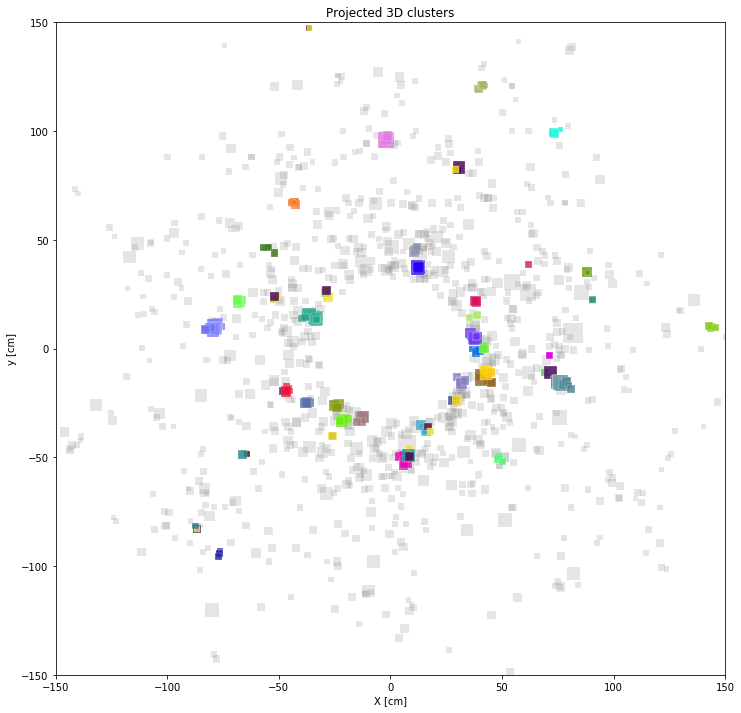

In [24]:
plotProj3DClusters(new2Dcls, cl3D)

----------------
energy                                                     37.2531
eta                                                        2.13433
phi                                                         3.0188
energyCore                                                 32.8397
energyCentral                                              26.9507
pt                                                         8.69415
layers           [1.0, 2.0, 5.0, 6.0, 7.0, 9.0, 10.0, 11.0, 12....
clusters         [14, 83, 132, 139, 143, 149, 151, 155, 157, 16...
nclu                                                            18
firstlayer                                                       1
showerlength                                                     1
seetot                                                           1
seemax                                                           1
spptot                                                           1
sppmax                                       

----------------
energy                                                     2.38807
eta                                                        2.86662
phi                                                     -0.0287524
energyCore                                                 2.38807
energyCentral                                             0.891054
pt                                                        0.270842
layers                               [1.0, 19.0, 20.0, 21.0, 23.0]
clusters                                  [38, 216, 255, 312, 407]
nclu                                                             5
firstlayer                                                       1
showerlength                                                     1
seetot                                                           1
seemax                                                           1
spptot                                                           1
sppmax                                       

[ 17  84 175 491 607]
                        cells    energy  energyCore       eta  layer  \
17                     [4329]  0.259246    0.259246  2.889701    1.0   
84   [4485, 4489, 4492, 4493]  1.280393    1.280393  2.933165    2.0   
175  [8268, 8269, 8270, 8271]  1.322511    0.836532  2.927263   16.0   
491                    [8966]  0.248013    0.248013  2.961219   25.0   
607                    [9112]  0.907892    0.907892  2.968431   28.0   

     nCoreCells  ncells       phi          x          y           z  zside  
17          1.0     1.0 -2.347295 -25.069866 -25.520115  320.755005    1.0  
84          4.0     4.0 -2.309475 -23.110473 -25.377452  321.505005    1.0  
175         3.0     4.0 -2.336359 -25.001979 -26.014022  335.964996    1.0  
491         1.0     1.0 -2.293228 -23.800797 -27.004028  346.814972    1.0  
607         1.0     1.0 -2.291768 -23.833883 -27.121294  350.404999    1.0  
----------------
energy                                                     4.74454

                                    cells    energy  energyCore       eta  \
41                                 [4369]  0.161954    0.161954  2.712840   
95                     [4548, 4549, 4550]  0.775086    0.775086  2.692853   
118              [4812, 4813, 4814, 4816]  1.079674    1.079674  2.677026   
129  [5117, 5118, 5119, 5120, 5121, 5122]  2.374103    1.687727  2.685272   
136                    [5442, 5443, 5446]  0.661391    0.111168  2.649293   

     layer  nCoreCells  ncells       phi          x          y           z  \
41     1.0         1.0     1.0 -0.213216  41.783108  -9.046309  320.755005   
95     2.0         3.0     3.0 -0.223746  42.634197  -9.701687  321.505005   
118    3.0         4.0     4.0 -0.235259  43.369649 -10.395621  322.735016   
129    4.0         4.0     6.0 -0.267597  42.753488 -11.721860  323.485016   
136    5.0         1.0     3.0 -0.244881  44.769407 -11.187693  324.714996   

     zside  
41     1.0  
95     1.0  
118    1.0  
129    1.0  
136

----------------
energy                                                   4.02106
eta                                                      2.59954
phi                                                     -1.40294
energyCore                                               3.18422
energyCentral                                            3.76827
pt                                                      0.594308
layers                                         [1.0, 13.0, 16.0]
clusters                                          [31, 163, 178]
nclu                                                           3
firstlayer                                                     1
showerlength                                                   1
seetot                                                         1
seemax                                                         1
spptot                                                         1
sppmax                                                         1
szz     

      cells    energy  energyCore       eta  layer  nCoreCells  ncells  \
245  [8656]  0.305282    0.305282  2.659058   20.0         1.0     1.0   
438  [8907]  0.187673    0.187673  2.673618   24.0         1.0     1.0   
533  [9020]  0.571571    0.571571  2.680819   26.0         1.0     1.0   

          phi          x          y           z  zside  
245 -2.144126 -25.976999 -40.232273  340.324982    1.0  
438 -2.144126 -25.976999 -40.232273  345.364990    1.0  
533 -2.144126 -25.976999 -40.232273  347.885010    1.0  
----------------
energy                                                    0.728936
eta                                                        2.01084
phi                                                       0.242564
energyCore                                                0.728936
energyCentral                                             0.310215
pt                                                        0.191738
layers                                          [20.0, 2

549  0.067348  145.609612   9.821320  347.885010    1.0  
----------------
energy                                                  0.982679
eta                                                      2.15493
phi                                                     -2.50495
energyCore                                              0.982679
energyCentral                                                  0
pt                                                      0.224787
layers                                        [24.0, 25.0, 26.0]
clusters                                         [442, 493, 535]
nclu                                                           3
firstlayer                                                    24
showerlength                                                   1
seetot                                                         1
seemax                                                         1
spptot                                                         1
sppmax         

            cells    energy  energyCore       eta  layer  nCoreCells  ncells  \
390        [8846]  0.296475    0.296475  2.497664   23.0         1.0     1.0   
527        [9013]  0.347313    0.347313  2.523832   26.0         1.0     1.0   
569  [9070, 9071]  0.703654    0.703654  2.512358   27.0         2.0     2.0   

          phi          x          y           z  zside  
390  2.733912 -52.366329  22.615772  344.294983    1.0  
527  2.698892 -50.716999  24.044136  347.885010    1.0  
569  2.707518 -51.732658  23.981308  349.334991    1.0  
----------------
energy                                                    2.07654
eta                                                       -2.7342
phi                                                   0.000167062
energyCore                                                2.07654
energyCentral                                                   0
pt                                                       0.268592
layers                                

991  2.140274 -43.018723  67.192451 -345.365021   -1.0  
----------------
energy                                                   0.799263
eta                                                      -1.76624
phi                                                      -2.38171
energyCore                                               0.799263
energyCentral                                            0.476338
pt                                                       0.265544
layers                                         [18.0, 21.0, 22.0]
clusters                                          [791, 862, 908]
nclu                                                            3
firstlayer                                                     18
showerlength                                                    1
seetot                                                          1
seemax                                                          1
spptot                                                          1
sp

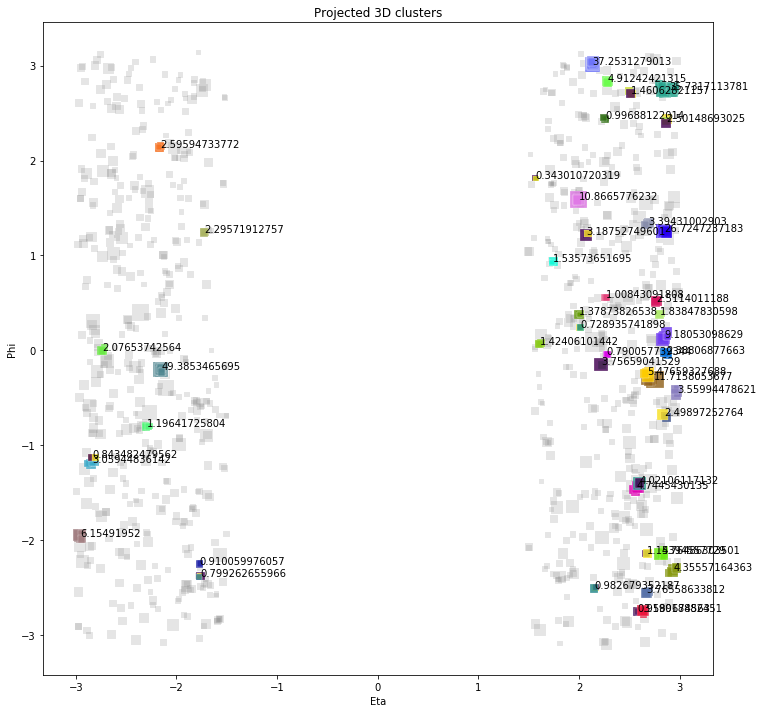

In [25]:
plotProj3DClustersEtaPhi(new2Dcls, cl3D)

In [26]:
my_mcl3D = pd.DataFrame(columns=['energy'])
my_mcl3D = my_mcl3D.append(clAlgo.build3DClustersProj(mcl2d))
print  my_mcl3D
print my_mcl3D.shape
print len(my_mcl3D)
print my_mcl3D.size

print len(mcl2d)

colorlista = [np.random.rand(3,) for range in (0, my_mcl3D.shape[0])]
print colorlista
my_mcl3D['color'] = colorlista

print my_mcl3D.sort(columns='energy', ascending=False)
print len(my_mcl3D.clusters.iloc[0])

AttributeError: 'DataFrame' object has no attribute 'x'

In [ ]:
plotProj3DClustersEtaPhi(mcl2d, my_mcl3D)

In [ ]:
my_cl3D = pd.DataFrame(columns=['energy'])
my_cl3D = my_cl3D.append(clAlgo.build3DClusters(cl2d))

colorlist = [np.random.rand(3,) for range in (0, my_cl3D.shape[0])]
my_cl3D['color'] = colorlist

print len(cl2d)
print my_cl3D.sort(columns='energy', ascending=False)
print len(my_cl3D.clusters.iloc[0])

In [ ]:
plotProj3DClustersEtaPhi(cl2d, my_cl3D, xlim=[1.5, 3])

# Estimate the energy density in the eps cone for DBSCAN tuning

### Signal Ele 50GeV PU0

The canvas contains an object of a type jsROOT cannot currently handle (TProfile). Falling back to a static png.


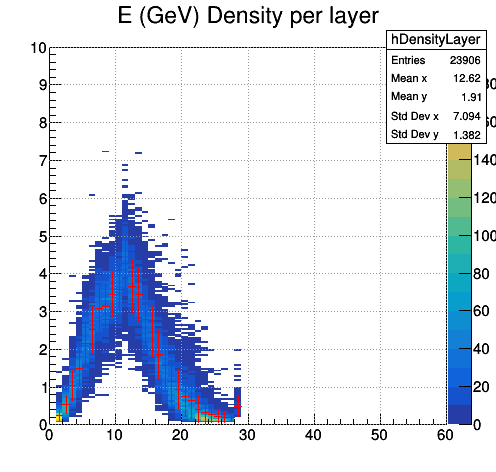

In [27]:

rfile = ROOT.TFile('testE50DENS.root','r')
#testBB.root -> alternatively takes the maximum per layer and ignores clustering...probably more suited for signal?
hDensity = rfile.Get('hDensityLayer')
drawAndProfileX(hDensity, options='COLZ',maxy=30)

hDensity_layer = [hDensity.ProjectionY(uuid.uuid4().hex[:6], layer, layer) for layer in range(2, 30)]

for idx in range(0,len(hDensity_layer)):
    hDensity_layer[idx].SetTitle('Layer {}'.format(idx+1))

#for layer in range(1, 29):
#    draw(hDensity.ProjectionY(uuid.uuid4().hex[:6], layer, layer))


In [28]:
for hlayer in hDensity_layer:
    draw(hlayer)

The canvas contains an object of a type jsROOT cannot currently handle (TProfile). Falling back to a static png.


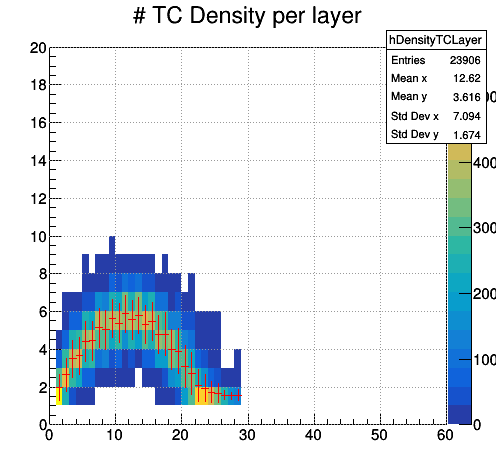

In [29]:
#testBB.root -> alternatively takes the maximum per layer and ignores clustering...probably more suited for signal?
hDensityTC = rfile.Get('hDensityTCLayer')
drawAndProfileX(hDensityTC, options='COLZ',maxy=30)

hDensityTC_layer = [hDensityTC.ProjectionY(uuid.uuid4().hex[:6], layer, layer) for layer in range(2, 30)]

for idx in range(0,len(hDensityTC_layer)):
    hDensityTC_layer[idx].SetTitle('Layer {}'.format(idx+1))

#fo

In [30]:
for hlayer in hDensityTC_layer:
    draw(hlayer)

### Signal Ele 25GeV PU0

The canvas contains an object of a type jsROOT cannot currently handle (TProfile). Falling back to a static png.


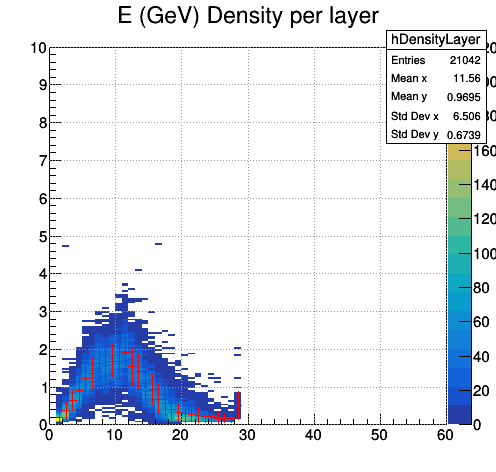

In [31]:

rfile_e25 = ROOT.TFile('testE25DENS.root','r')
hDensity_e25 = rfile_e25.Get('hDensityLayer')
drawAndProfileX(hDensity_e25, options='COLZ',maxy=30)

hDensity_e25_layer = [hDensity_e25.ProjectionY(uuid.uuid4().hex[:6], layer, layer) for layer in range(2, 30)]
for idx in range(0,len(hDensity_e25_layer)):
    hDensity_e25_layer[idx].SetTitle('Layer {}'.format(idx+1))


In [32]:
for hlayer in hDensity_e25_layer:
    draw(hlayer)

The canvas contains an object of a type jsROOT cannot currently handle (TProfile). Falling back to a static png.


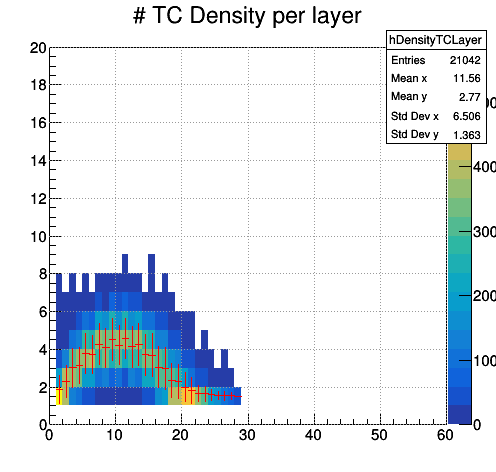

In [33]:
hDensityTC_e25 = rfile_e25.Get('hDensityTCLayer')
drawAndProfileX(hDensityTC_e25, options='COLZ',maxy=30)

hDensityTC_e25_layer = [hDensityTC_e25.ProjectionY(uuid.uuid4().hex[:6], layer, layer) for layer in range(2, 30)]
for idx in range(0,len(hDensityTC_e25_layer)):
    hDensityTC_e25_layer[idx].SetTitle('Layer {}'.format(idx+1))


In [34]:
for hlayer in hDensityTC_e25_layer:
    draw(hlayer)

### NuGUN PU200

The canvas contains an object of a type jsROOT cannot currently handle (TProfile). Falling back to a static png.


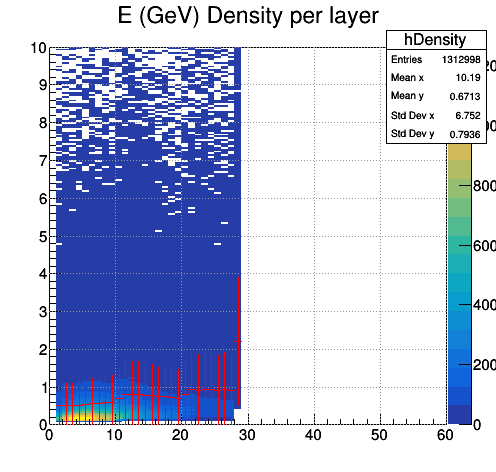

In [35]:

rfilePU = ROOT.TFile('testBBB.root','r')
hDensityPU = rfilePU.Get('hDensity')
drawAndProfileX(hDensityPU, options='COLZ',maxy=30)

hDensityPU_layer = [hDensityPU.ProjectionY(uuid.uuid4().hex[:6], layer, layer) for layer in range(2, 30)]
for idx in range(0,len(hDensityPU_layer)):
    hDensityPU_layer[idx].SetTitle('Layer {}'.format(idx+1))


In [36]:
for hlayer in hDensityPU_layer:
    draw(hlayer)

In [37]:
#print hDensity_layer
#print hDensityPU_layer
for layer in range(0, 28):
    drawSame([hDensityPU_layer[layer], hDensity_layer[layer], hDensity_e25_layer[layer]], 
             ['nu gun PU200', 'signal E50', 'signal E25'], options="hist", norm=True)

In [ ]:
# testAAA -> PU0 E50 using clusters
# testCCC -> PU0 E25 using clusters
# testBB  -> PU0 E50 not using cluisters
# testBBB -> PU 200 nugun using clusters


In [38]:
for layer in range(0, 28):
    drawSame([hDensityTC_layer[layer], hDensityTC_e25_layer[layer]], 
             ['signal E50', 'signal E25'], options="hist", norm=True)